In [1]:
!pip install tensorflow
!pip install tifffile
!pip install matplotlib
!pip install scikit-learn
!pip install numpy

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
import tensorflow as tf
from tensorflow.keras.models import load_model
import numpy as np
import matplotlib.pyplot as plt
from scipy import ndimage
import tifffile as tiff


In [8]:
# Load the test images and masks
test_images_path = '/content/drive/MyDrive/Mitochondria-Data/Data/test/testing.tif'
test_masks_path = '/content/drive/MyDrive/Mitochondria-Data/Data/test/testing_groundtruth.tif'

test_images = tiff.imread(test_images_path)
test_masks = tiff.imread(test_masks_path)

# Expand dimensions if necessary
if len(test_images.shape) == 3:
    test_images = np.expand_dims(test_images, axis=-1)
if len(test_masks.shape) == 3:
    test_masks = np.expand_dims(test_masks, axis=-1)

# Resize images
def resize_images(images, new_size=(128, 128)):
    resized_images = np.zeros((images.shape[0], new_size[0], new_size[1], images.shape[3]))
    for i in range(images.shape[0]):
        resized_images[i] = tf.image.resize(images[i], new_size)
    return resized_images

resized_test_images = resize_images(test_images)
resized_test_masks = resize_images(test_masks)

# Normalize the images
resized_test_images = resized_test_images / 255.0
resized_test_masks = resized_test_masks / 255.0

# Check Resized images shape
print(f"Resized test images shape: {resized_test_images.shape}")
print(f"Resized test masks shape: {resized_test_masks.shape}")


Resized test images shape: (165, 128, 128, 1)
Resized test masks shape: (165, 128, 128, 1)


In [5]:
# Load the trained model
model = load_model('/content/drive/MyDrive/Mitochondria-Data/Data/u-net-model/mitochondria_unet_model_2024.h5')

# Check the model summary
model.summary()

# Predict on all test data
all_test_predictions = model.predict(resized_test_images)


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 128, 128, 1)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d (Conv2D)           │ (None, 128, 128, 64)   │            640 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1 (Conv2D)         │ (None, 128, 128, 64)   │         36,928 │ conv2d[0][0]           │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d             │ (None, 64, 64, 64)     │              0 │ conv2d_1[0][0]         │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_2 (Conv2D)         │ (None, 64, 64, 128)    │         73,856 │ max_pooling2d[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_3 (Conv2D)         │ (None, 64, 64, 128)    │        147,584 │ conv2d_2[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_1           │ (None, 32, 32, 128)    │              0 │ conv2d_3[0][0]         │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_4 (Conv2D)         │ (None, 32, 32, 256)    │        295,168 │ max_pooling2d_1[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_5 (Conv2D)         │ (None, 32, 32, 256)    │        590,080 │ conv2d_4[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_2           │ (None, 16, 16, 256)    │              0 │ conv2d_5[0][0]         │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_6 (Conv2D)         │ (None, 16, 16, 512)    │      1,180,160 │ max_pooling2d_2[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_7 (Conv2D)         │ (None, 16, 16, 512)    │      2,359,808 │ conv2d_6[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_3           │ (None, 8, 8, 512)      │              0 │ conv2d_7[0][0]         │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_8 (Conv2D)         │ (None, 8, 8, 1024)     │      4,719,616 │ max_pooling2d_3[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_9 (Conv2D)         │ (None, 8, 8, 1024)     │      9,438,208 │ conv2d_8[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_transpose          │ (None, 16, 16, 512)    │      2,097,664 │ conv2d_9[0][0]         │
│ (Conv2DTranspose)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate (Concatenate) │ (None, 16, 16, 1024)   │              0 │ conv2d_transpose[0][0… │
│                      

 Total params: 31,030,595 (118.37 MB)

 Trainable params: 31,030,593 (118.37 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 2 (12.00 B)

6/6 ━━━━━━━━━━━━━━━━━━━━ 23s 1s/step


In [6]:
# Function to find centroids
def find_centroids(mask):
    mask = mask > 0.5  # Thresholding the mask
    labeled_mask, num_labels = ndimage.label(mask)
    centroids = []
    for label in range(1, num_labels + 1):
        positions = np.where(labeled_mask == label)
        if len(positions[0]) == 0 or len(positions[1]) == 0:
            continue
        centroid_y = np.mean(positions[0])
        centroid_x = np.mean(positions[1])
        centroids.append((int(centroid_x), int(centroid_y)))
    return centroids

def plot_results(index, original_image, true_mask, predicted_mask):
    predicted_mask = np.clip(predicted_mask, 0, 1)  # Ensure mask is within correct range
    centroids = find_centroids(predicted_mask)

    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.title("Original Image")
    plt.imshow(original_image.squeeze(), cmap='gray')

    plt.subplot(1, 3, 2)
    plt.title("True Mask")
    plt.imshow(true_mask.squeeze(), cmap='gray')

    plt.subplot(1, 3, 3)
    plt.title("Predicted Mask")
    plt.imshow(predicted_mask, cmap='gray')

    # Plot all centroids
    for centroid in centroids:
        plt.plot(centroid[0], centroid[1], 'ro')  # Mark centroids with red dots

    plt.show()

    # Print the coordinates of the centroids
    print(f"Centroids of predicted mask {index}: {centroids}")


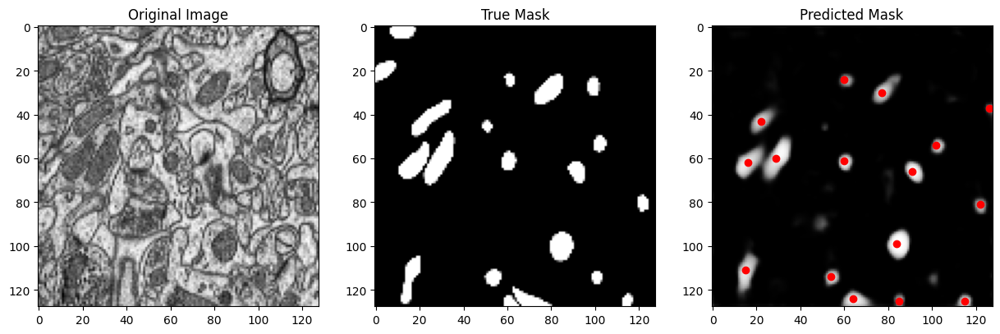

Centroids of predicted mask 0: [(60, 24), (77, 30), (126, 37), (22, 43), (29, 60), (102, 54), (16, 62), (60, 61), (91, 66), (122, 81), (84, 99), (15, 111), (54, 114), (64, 124), (115, 125), (85, 125)]


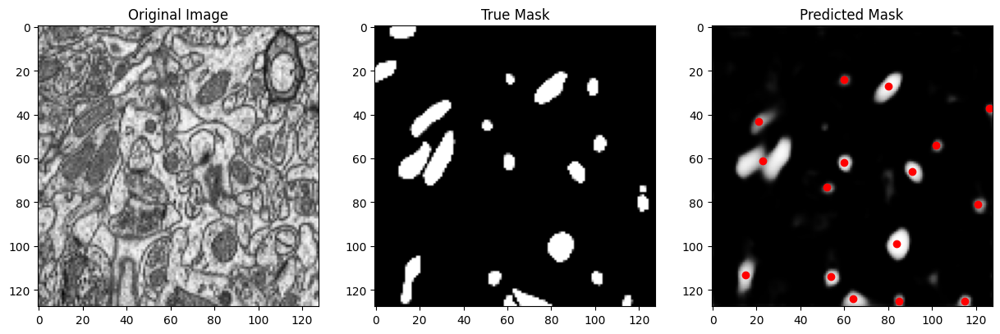

Centroids of predicted mask 1: [(80, 27), (60, 24), (126, 37), (21, 43), (23, 61), (102, 54), (60, 62), (91, 66), (52, 73), (121, 81), (84, 99), (15, 113), (54, 114), (64, 124), (85, 125), (115, 125)]


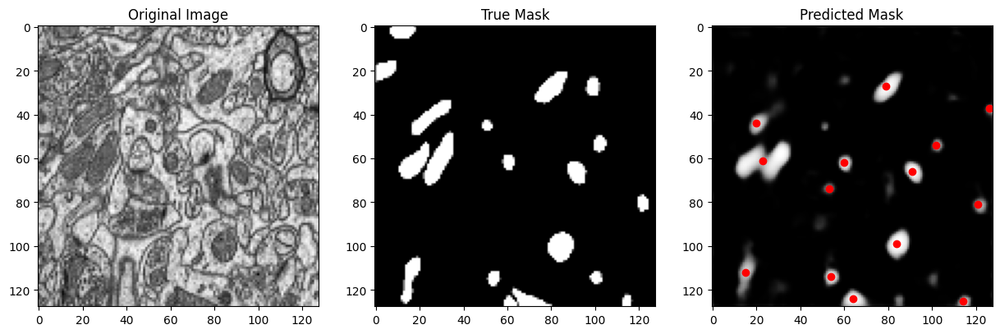

Centroids of predicted mask 2: [(79, 27), (126, 37), (20, 44), (23, 61), (102, 54), (60, 62), (91, 66), (53, 74), (121, 81), (84, 99), (15, 112), (54, 114), (64, 124), (114, 125)]


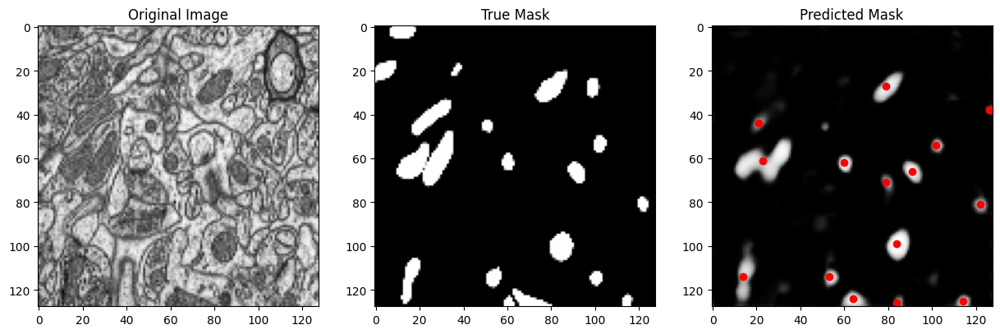

Centroids of predicted mask 3: [(79, 27), (126, 38), (21, 44), (23, 61), (102, 54), (60, 62), (91, 66), (79, 71), (122, 81), (84, 99), (14, 114), (53, 114), (64, 124), (114, 125), (84, 126)]


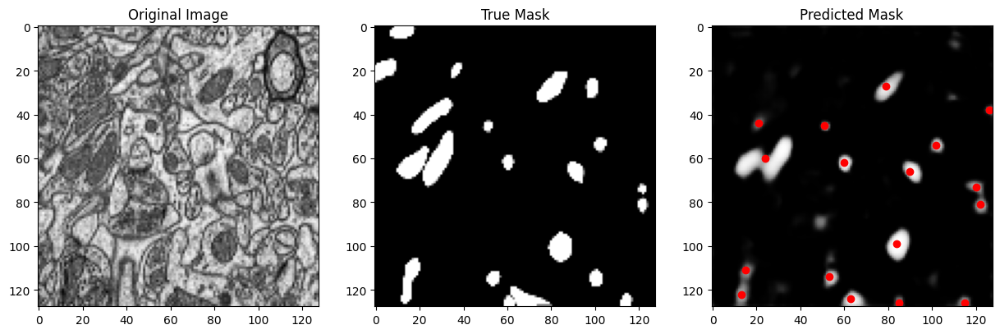

Centroids of predicted mask 4: [(79, 27), (126, 38), (21, 44), (51, 45), (24, 60), (102, 54), (60, 62), (90, 66), (120, 73), (122, 81), (84, 99), (15, 111), (53, 114), (13, 122), (63, 124), (85, 126), (115, 126)]


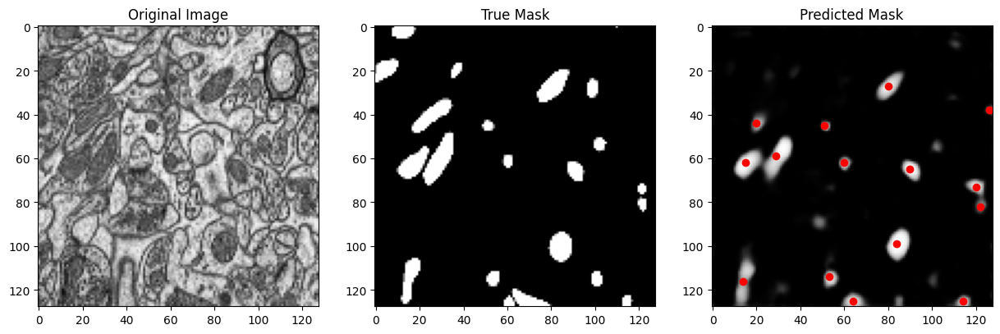

Centroids of predicted mask 5: [(80, 27), (126, 38), (20, 44), (51, 45), (29, 59), (15, 62), (60, 62), (90, 65), (120, 73), (122, 82), (84, 99), (14, 116), (53, 114), (64, 125), (114, 125)]


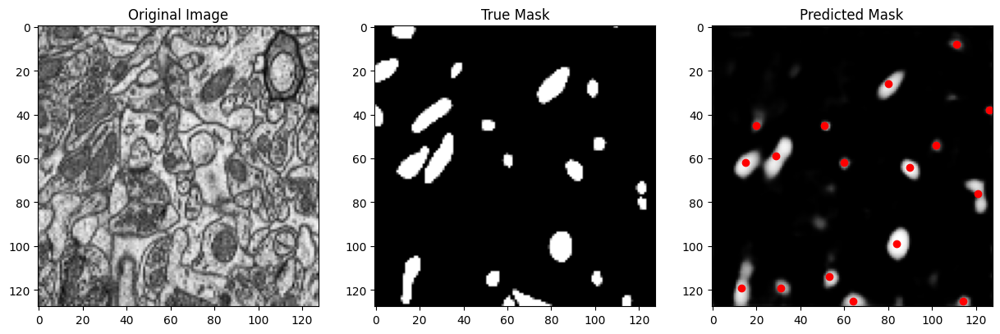

Centroids of predicted mask 6: [(111, 8), (80, 26), (126, 38), (51, 45), (20, 45), (29, 59), (102, 54), (15, 62), (90, 64), (60, 62), (121, 76), (84, 99), (13, 119), (53, 114), (31, 119), (64, 125), (114, 125)]


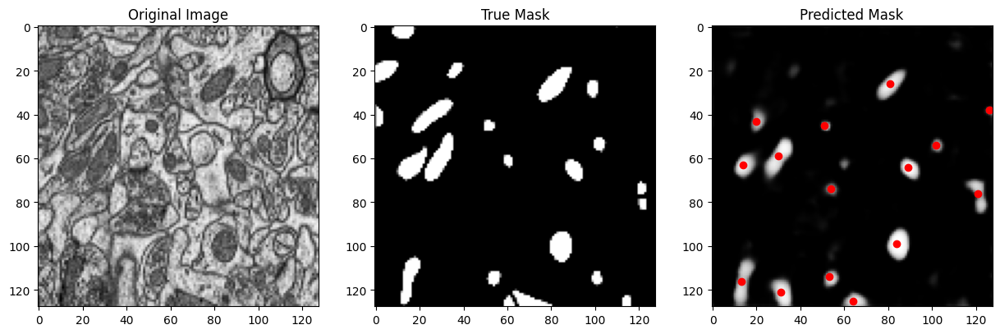

Centroids of predicted mask 7: [(81, 26), (126, 38), (20, 43), (51, 45), (30, 59), (102, 54), (14, 63), (89, 64), (121, 76), (54, 74), (84, 99), (13, 116), (53, 114), (31, 121), (64, 125)]


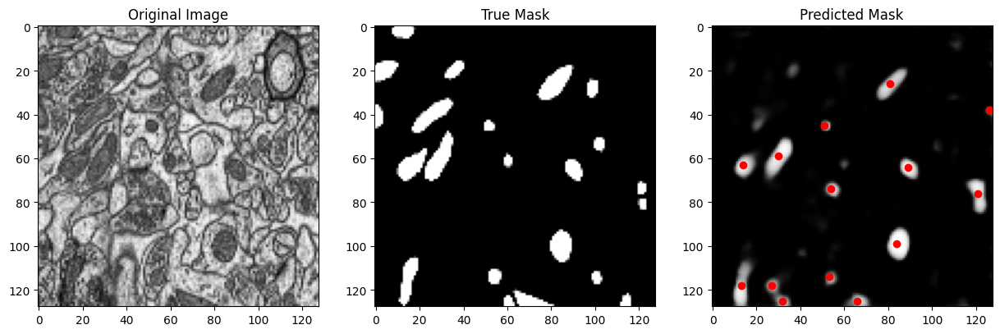

Centroids of predicted mask 8: [(81, 26), (126, 38), (51, 45), (30, 59), (14, 63), (89, 64), (121, 76), (54, 74), (84, 99), (13, 118), (53, 114), (27, 118), (66, 125), (32, 125)]


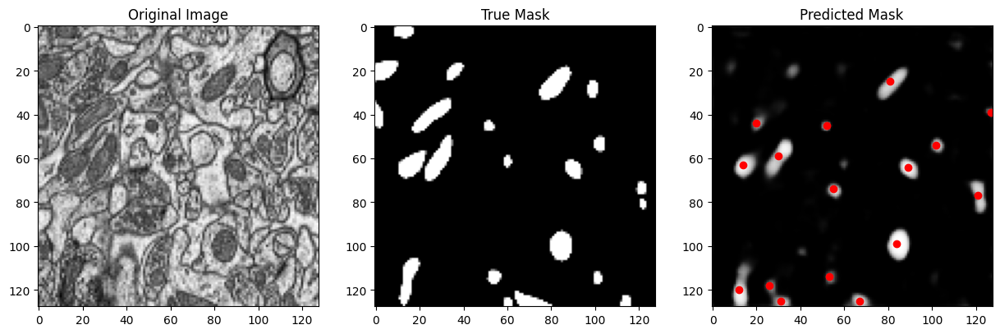

Centroids of predicted mask 9: [(81, 25), (127, 39), (20, 44), (52, 45), (30, 59), (102, 54), (14, 63), (89, 64), (121, 77), (55, 74), (84, 99), (12, 120), (53, 114), (26, 118), (67, 125), (31, 125)]


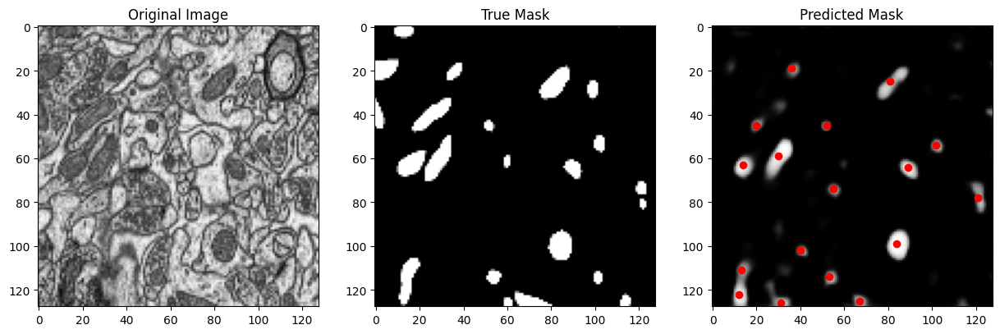

Centroids of predicted mask 10: [(36, 19), (81, 25), (20, 45), (52, 45), (30, 59), (102, 54), (14, 63), (89, 64), (55, 74), (121, 78), (84, 99), (40, 102), (13, 111), (53, 114), (12, 122), (67, 125), (31, 126)]


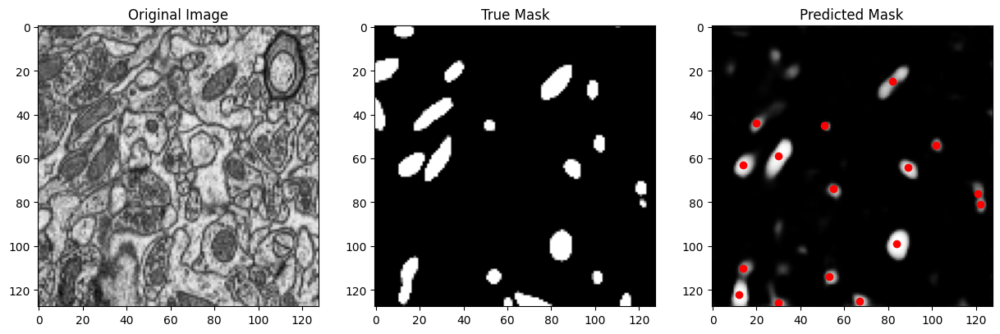

Centroids of predicted mask 11: [(82, 25), (20, 44), (51, 45), (30, 59), (102, 54), (14, 63), (89, 64), (55, 74), (121, 76), (122, 81), (84, 99), (14, 110), (53, 114), (12, 122), (67, 125), (30, 126)]


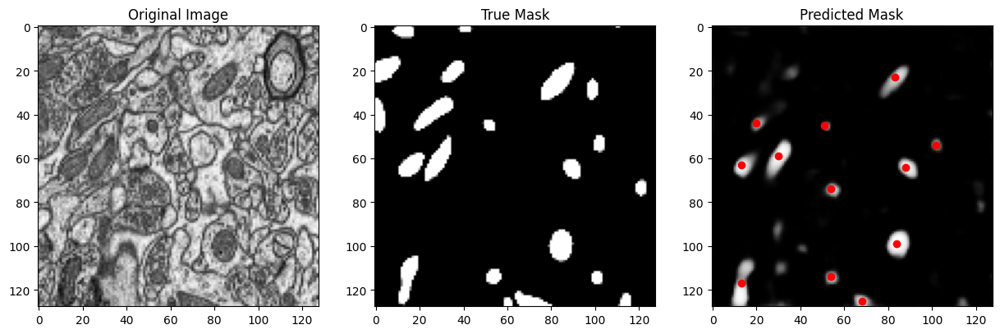

Centroids of predicted mask 12: [(83, 23), (20, 44), (51, 45), (30, 59), (102, 54), (13, 63), (88, 64), (54, 74), (84, 99), (13, 117), (54, 114), (68, 125)]


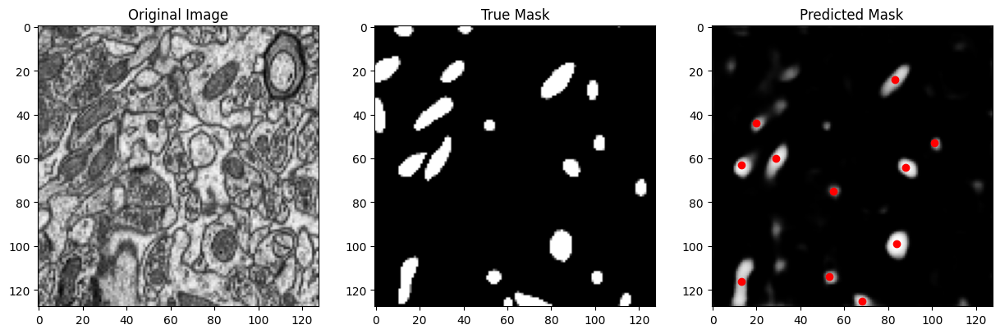

Centroids of predicted mask 13: [(83, 24), (20, 44), (101, 53), (29, 60), (13, 63), (88, 64), (55, 75), (84, 99), (13, 116), (53, 114), (68, 125)]


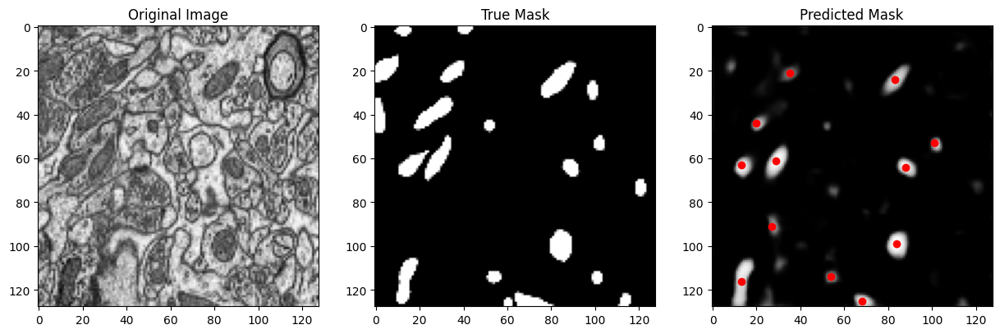

Centroids of predicted mask 14: [(83, 24), (35, 21), (20, 44), (101, 53), (29, 61), (13, 63), (88, 64), (27, 91), (84, 99), (13, 116), (54, 114), (68, 125)]


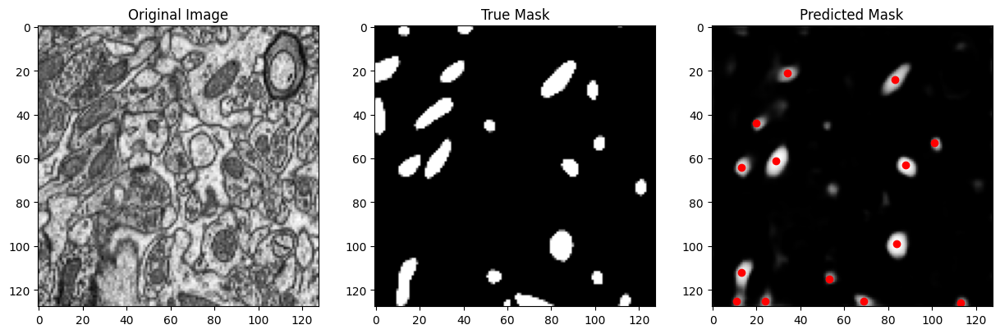

Centroids of predicted mask 15: [(83, 24), (34, 21), (20, 44), (101, 53), (29, 61), (88, 63), (13, 64), (84, 99), (13, 112), (53, 115), (11, 125), (24, 125), (69, 125), (113, 126)]


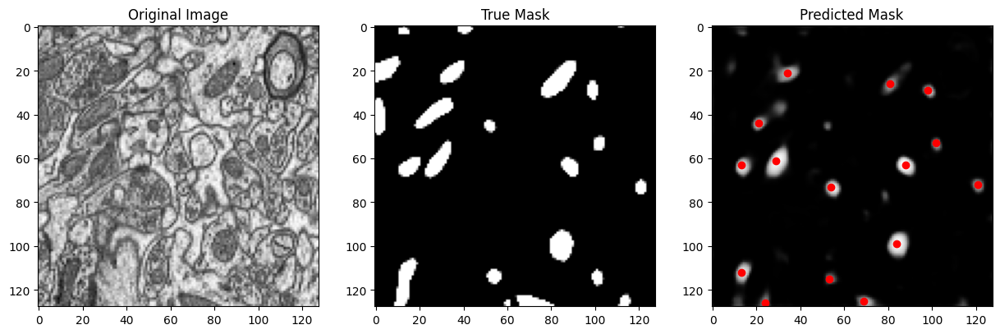

Centroids of predicted mask 16: [(34, 21), (81, 26), (98, 29), (21, 44), (102, 53), (29, 61), (88, 63), (13, 63), (54, 73), (121, 72), (84, 99), (13, 112), (53, 115), (69, 125), (24, 126)]


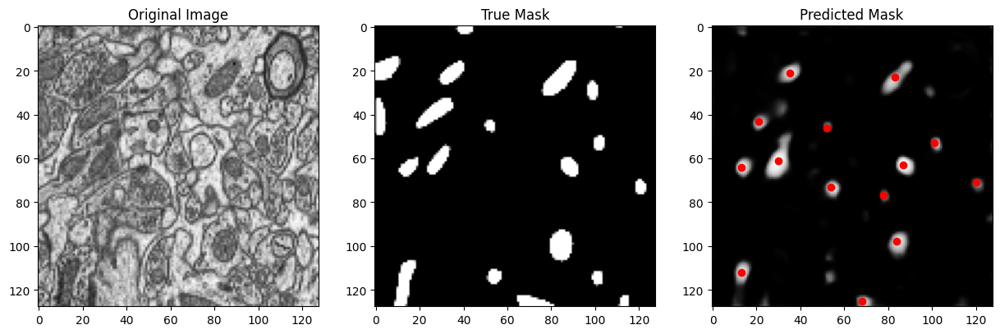

Centroids of predicted mask 17: [(83, 23), (35, 21), (21, 43), (52, 46), (30, 61), (101, 53), (87, 63), (13, 64), (54, 73), (120, 71), (78, 77), (84, 98), (13, 112), (68, 125)]


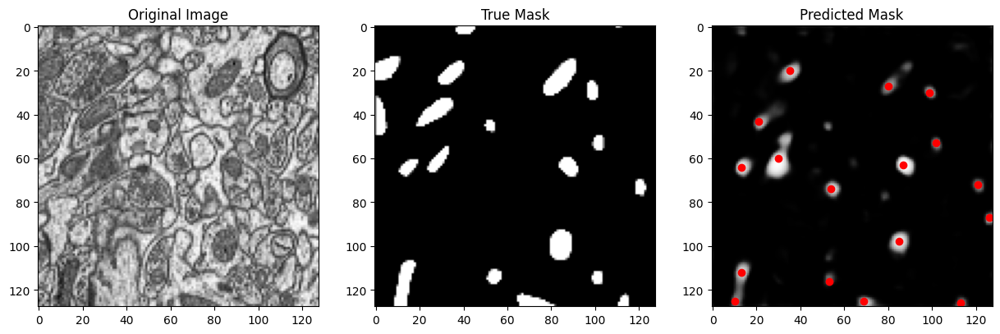

Centroids of predicted mask 18: [(35, 20), (80, 27), (99, 30), (21, 43), (30, 60), (102, 53), (87, 63), (13, 64), (54, 74), (121, 72), (126, 87), (85, 98), (13, 112), (53, 116), (10, 125), (69, 125), (113, 126)]


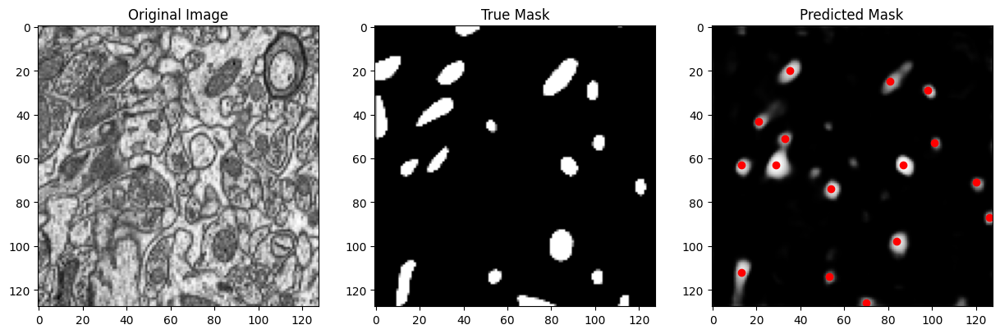

Centroids of predicted mask 19: [(35, 20), (81, 25), (98, 29), (21, 43), (33, 51), (101, 53), (29, 63), (87, 63), (13, 63), (120, 71), (54, 74), (126, 87), (84, 98), (13, 112), (53, 114), (70, 126)]


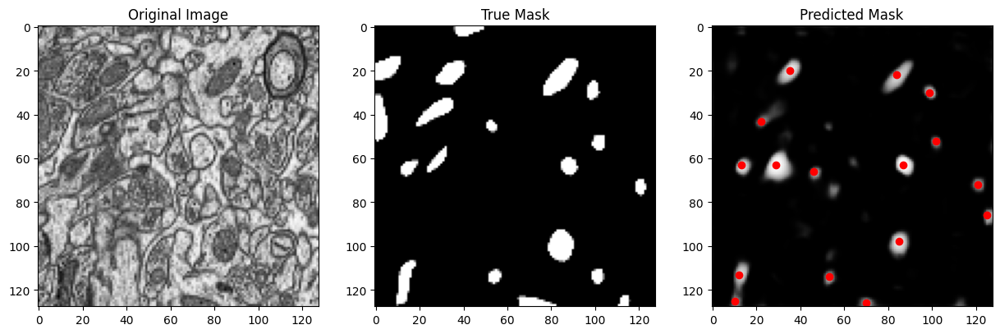

Centroids of predicted mask 20: [(35, 20), (84, 22), (99, 30), (22, 43), (102, 52), (29, 63), (87, 63), (13, 63), (46, 66), (121, 72), (125, 86), (85, 98), (12, 113), (53, 114), (10, 125), (70, 126)]


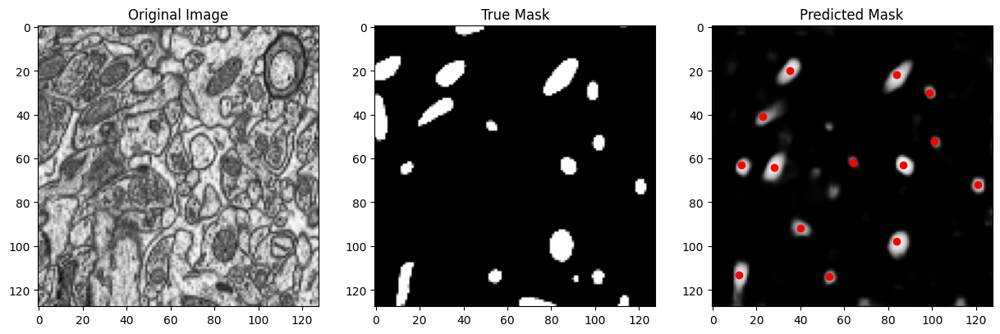

Centroids of predicted mask 21: [(35, 20), (84, 22), (99, 30), (23, 41), (101, 52), (28, 64), (87, 63), (13, 63), (64, 62), (121, 72), (40, 92), (84, 98), (12, 113), (53, 114)]


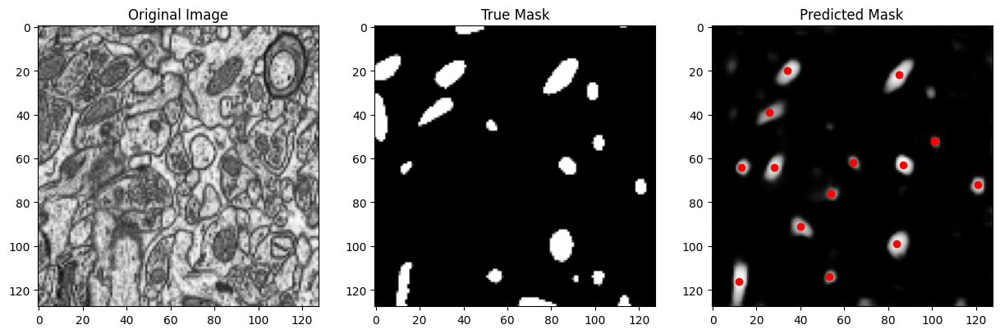

Centroids of predicted mask 22: [(34, 20), (85, 22), (26, 39), (101, 52), (87, 63), (28, 64), (64, 62), (13, 64), (121, 72), (54, 76), (40, 91), (84, 99), (12, 116), (53, 114)]


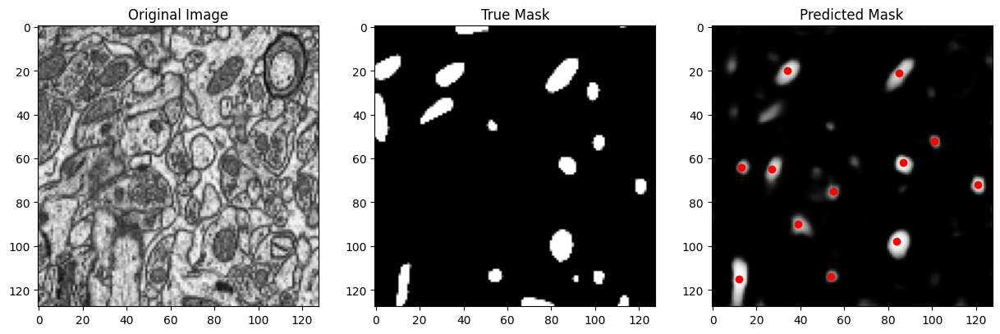

Centroids of predicted mask 23: [(34, 20), (85, 21), (101, 52), (87, 62), (27, 65), (13, 64), (121, 72), (55, 75), (39, 90), (84, 98), (12, 115), (54, 114)]


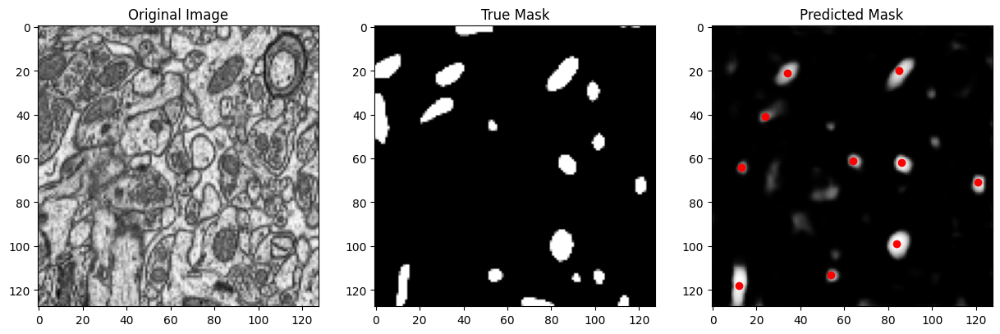

Centroids of predicted mask 24: [(85, 20), (34, 21), (24, 41), (64, 61), (86, 62), (13, 64), (121, 71), (84, 99), (12, 118), (54, 113)]


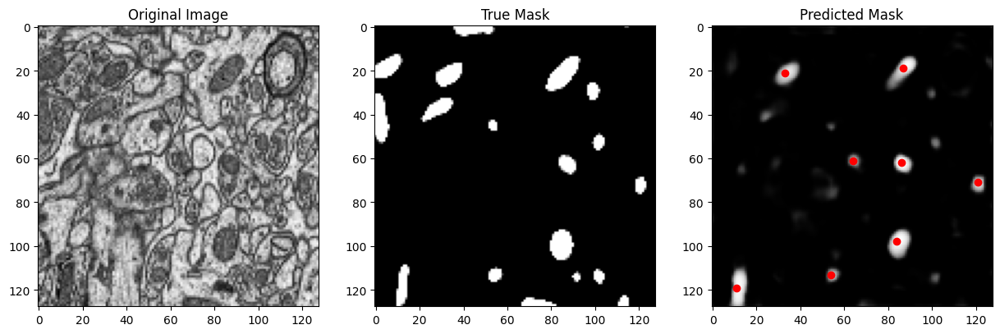

Centroids of predicted mask 25: [(87, 19), (33, 21), (86, 62), (64, 61), (121, 71), (84, 98), (11, 119), (54, 113)]


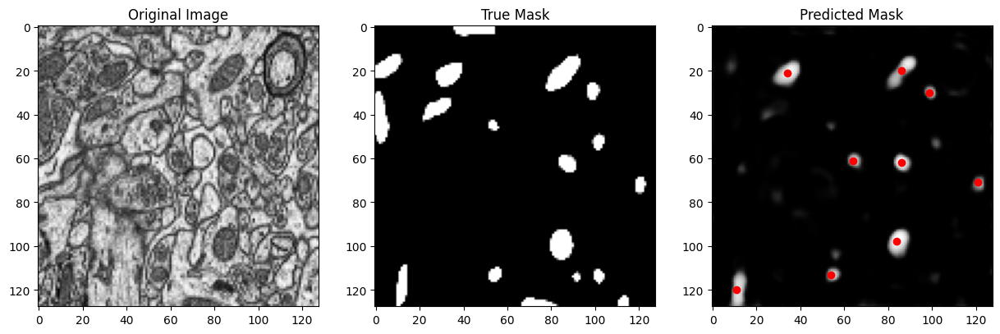

Centroids of predicted mask 26: [(86, 20), (34, 21), (99, 30), (64, 61), (86, 62), (121, 71), (84, 98), (54, 113), (11, 120)]


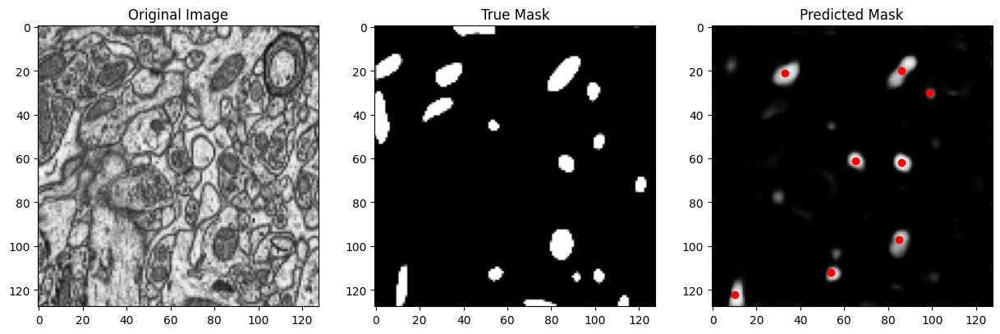

Centroids of predicted mask 27: [(86, 20), (33, 21), (99, 30), (65, 61), (86, 62), (85, 97), (54, 112), (10, 122)]


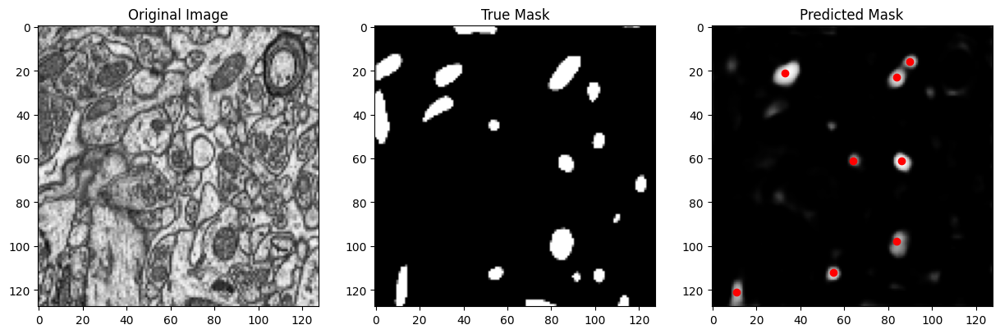

Centroids of predicted mask 28: [(90, 16), (33, 21), (84, 23), (86, 61), (64, 61), (84, 98), (55, 112), (11, 121)]


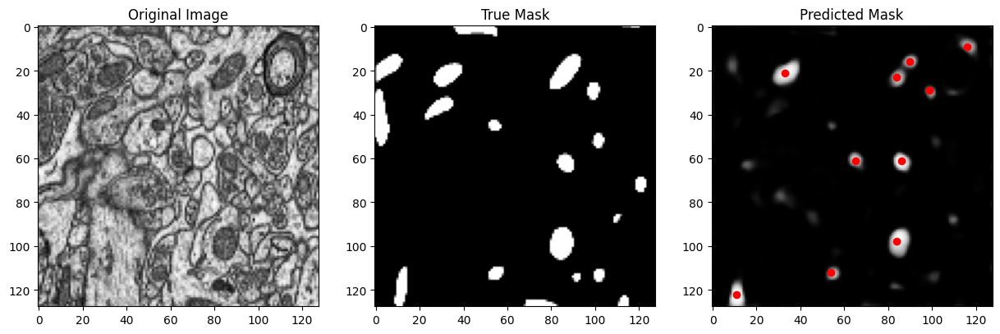

Centroids of predicted mask 29: [(116, 9), (90, 16), (33, 21), (84, 23), (99, 29), (86, 61), (65, 61), (84, 98), (54, 112), (11, 122)]


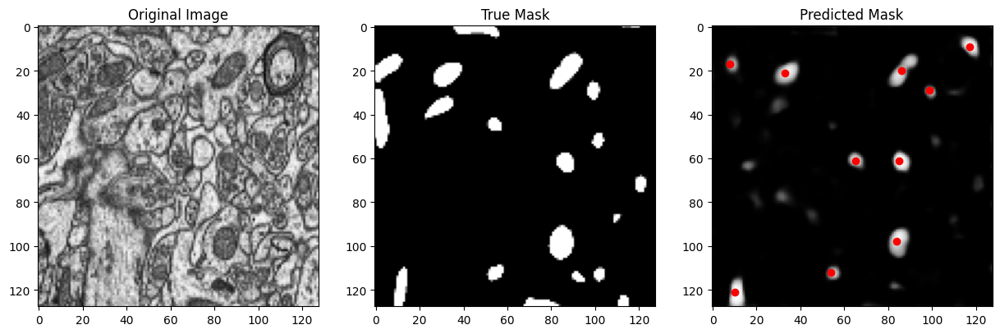

Centroids of predicted mask 30: [(117, 9), (86, 20), (8, 17), (33, 21), (99, 29), (85, 61), (65, 61), (84, 98), (54, 112), (10, 121)]


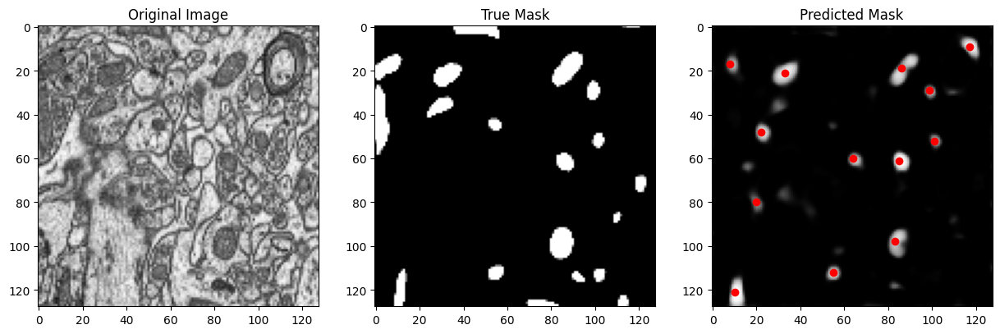

Centroids of predicted mask 31: [(117, 9), (86, 19), (8, 17), (33, 21), (99, 29), (22, 48), (101, 52), (85, 61), (64, 60), (20, 80), (83, 98), (55, 112), (10, 121)]


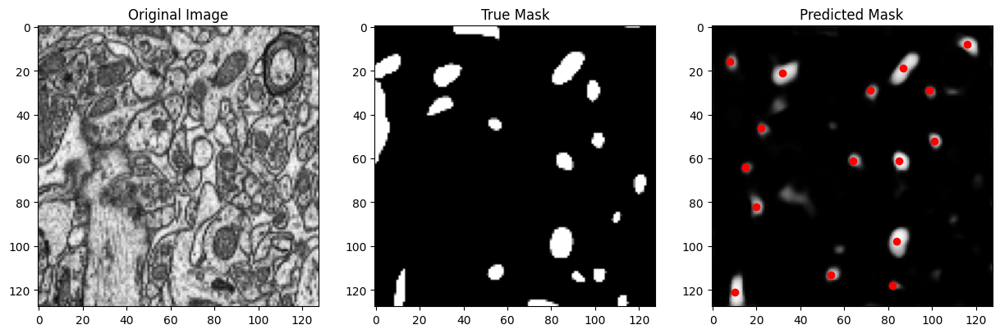

Centroids of predicted mask 32: [(116, 8), (87, 19), (8, 16), (32, 21), (72, 29), (99, 29), (22, 46), (101, 52), (85, 61), (64, 61), (15, 64), (20, 82), (84, 98), (54, 113), (10, 121), (82, 118)]


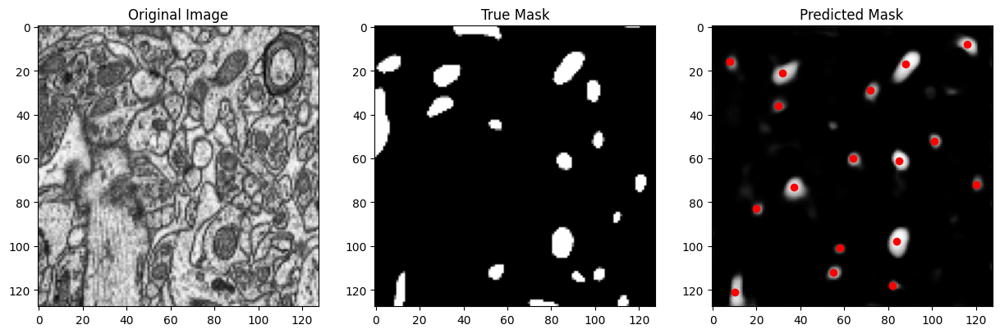

Centroids of predicted mask 33: [(116, 8), (88, 17), (8, 16), (32, 21), (72, 29), (30, 36), (101, 52), (85, 61), (64, 60), (37, 73), (120, 72), (20, 83), (84, 98), (58, 101), (55, 112), (10, 121), (82, 118)]


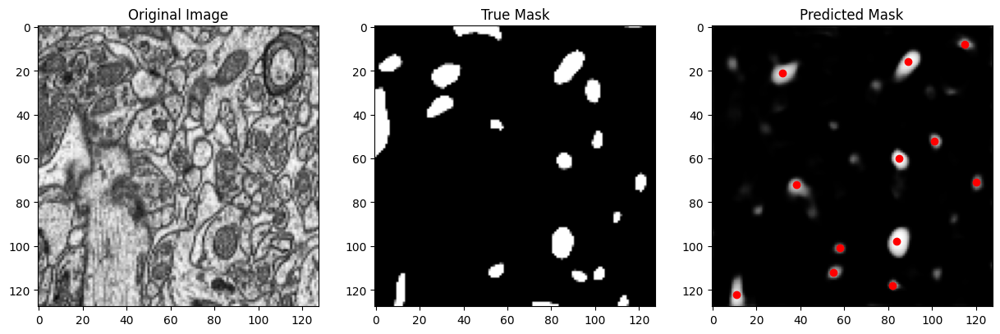

Centroids of predicted mask 34: [(115, 8), (89, 16), (32, 21), (101, 52), (85, 60), (38, 72), (120, 71), (84, 98), (58, 101), (55, 112), (11, 122), (82, 118)]


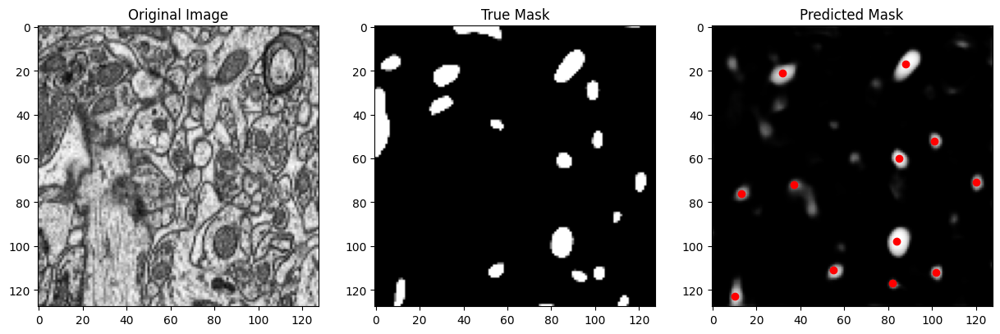

Centroids of predicted mask 35: [(88, 17), (32, 21), (101, 52), (85, 60), (120, 71), (37, 72), (13, 76), (84, 98), (55, 111), (102, 112), (82, 117), (10, 123)]


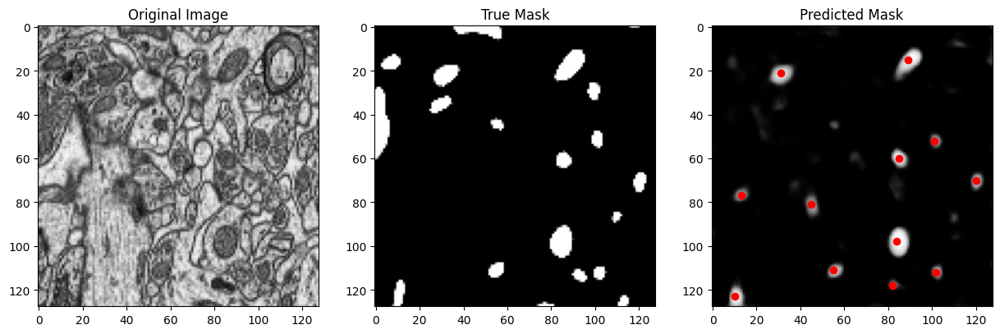

Centroids of predicted mask 36: [(89, 15), (31, 21), (101, 52), (85, 60), (120, 70), (13, 77), (45, 81), (84, 98), (55, 111), (102, 112), (82, 118), (10, 123)]


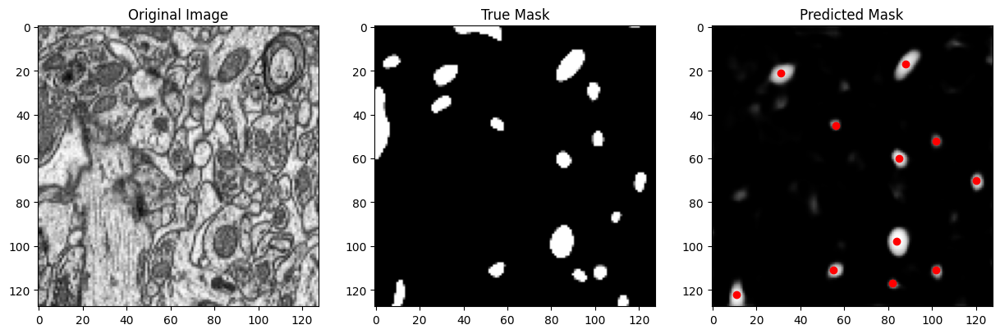

Centroids of predicted mask 37: [(88, 17), (31, 21), (56, 45), (102, 52), (85, 60), (120, 70), (84, 98), (55, 111), (102, 111), (82, 117), (11, 122)]


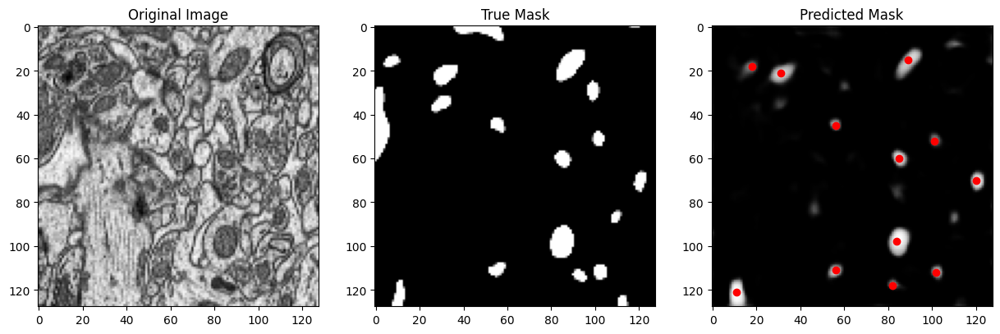

Centroids of predicted mask 38: [(89, 15), (18, 18), (31, 21), (56, 45), (101, 52), (85, 60), (120, 70), (84, 98), (56, 111), (102, 112), (11, 121), (82, 118)]


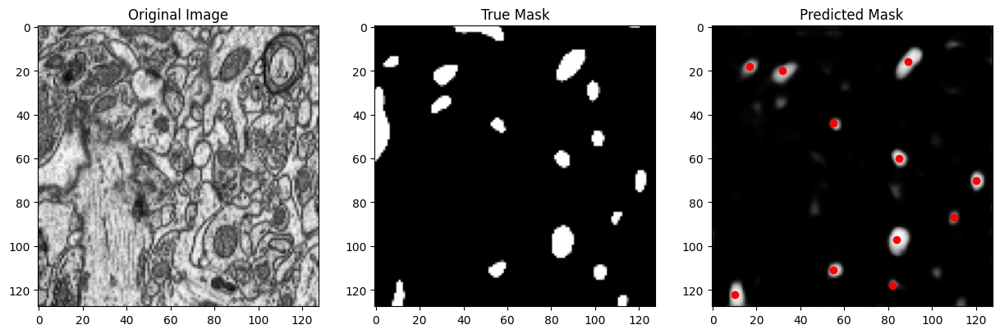

Centroids of predicted mask 39: [(89, 16), (17, 18), (32, 20), (55, 44), (85, 60), (120, 70), (110, 87), (84, 97), (55, 111), (10, 122), (82, 118)]


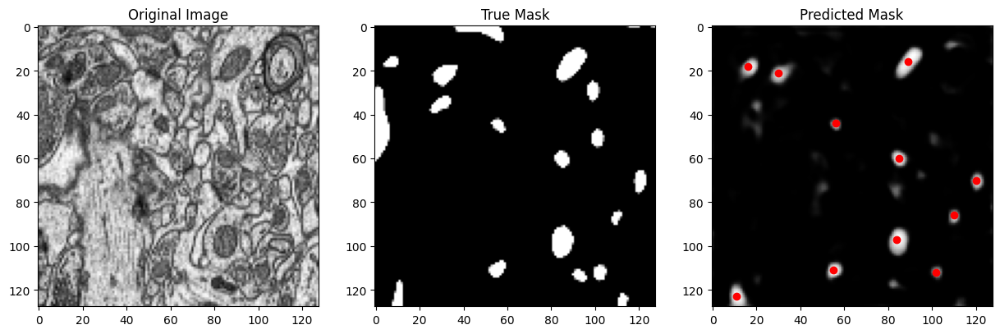

Centroids of predicted mask 40: [(89, 16), (16, 18), (30, 21), (56, 44), (85, 60), (120, 70), (110, 86), (84, 97), (55, 111), (102, 112), (11, 123)]


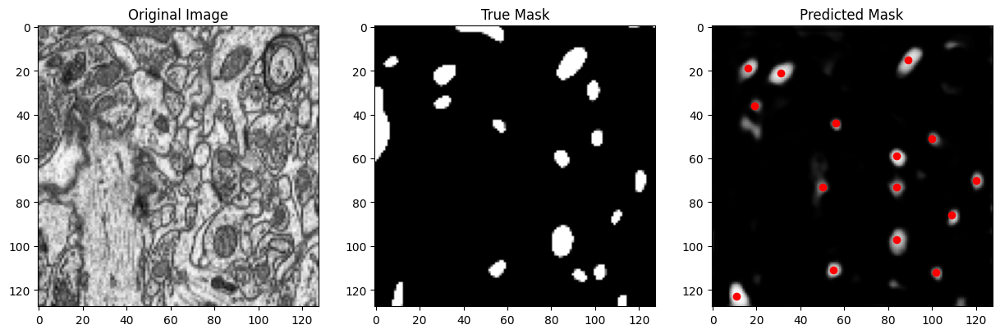

Centroids of predicted mask 41: [(89, 15), (16, 19), (31, 21), (19, 36), (56, 44), (100, 51), (84, 59), (120, 70), (84, 73), (50, 73), (109, 86), (84, 97), (55, 111), (102, 112), (11, 123)]


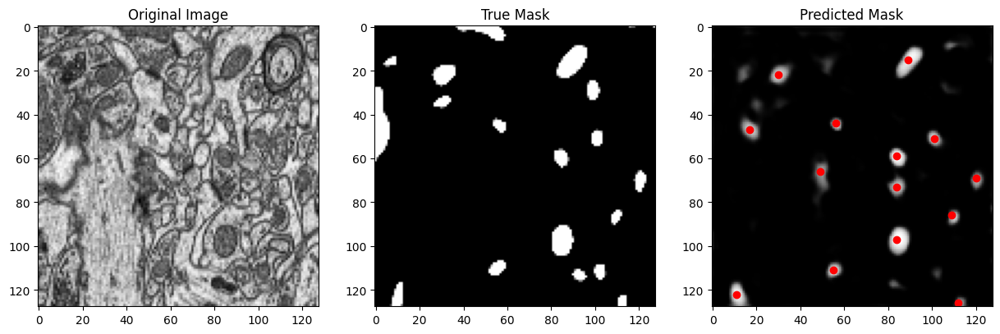

Centroids of predicted mask 42: [(89, 15), (30, 22), (56, 44), (17, 47), (101, 51), (84, 59), (49, 66), (120, 69), (84, 73), (109, 86), (84, 97), (55, 111), (11, 122), (112, 126)]


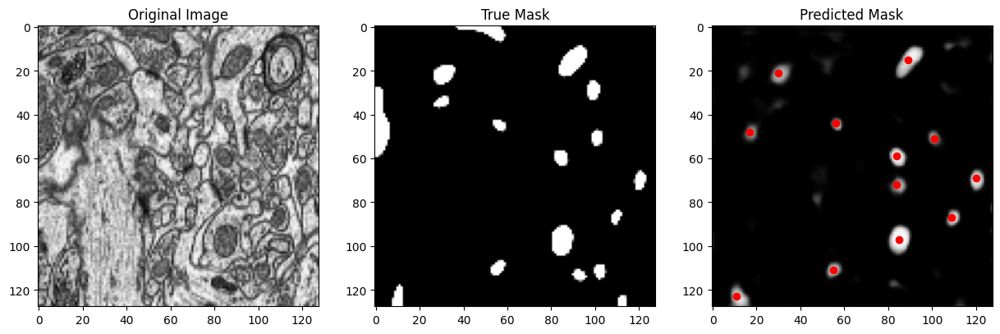

Centroids of predicted mask 43: [(89, 15), (30, 21), (56, 44), (17, 48), (101, 51), (84, 59), (120, 69), (84, 72), (109, 87), (85, 97), (55, 111), (11, 123)]


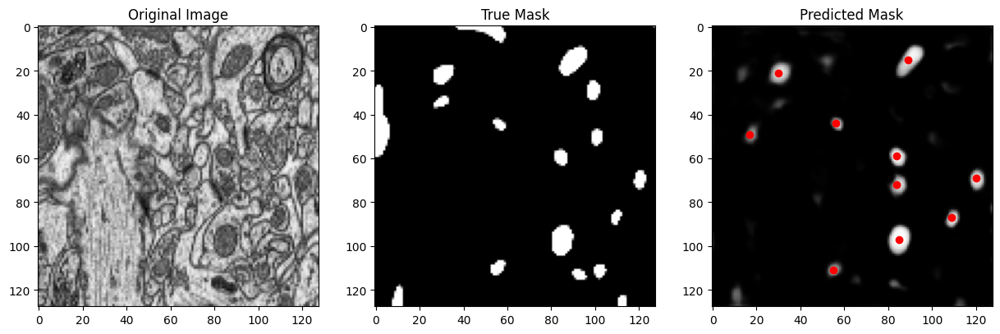

Centroids of predicted mask 44: [(89, 15), (30, 21), (56, 44), (17, 49), (84, 59), (120, 69), (84, 72), (109, 87), (85, 97), (55, 111)]


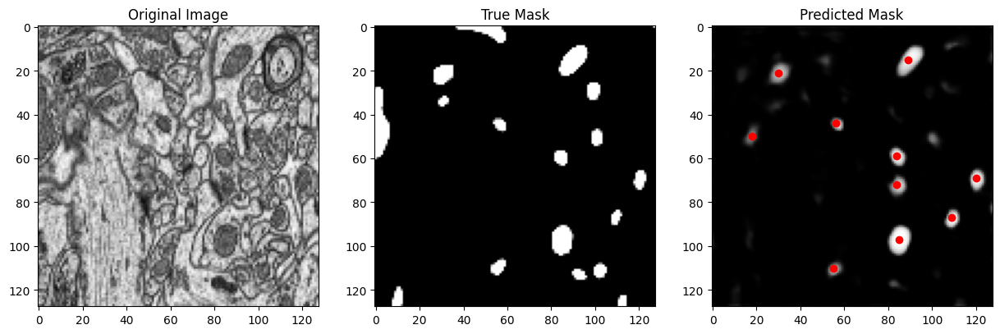

Centroids of predicted mask 45: [(89, 15), (30, 21), (56, 44), (18, 50), (84, 59), (120, 69), (84, 72), (109, 87), (85, 97), (55, 110)]


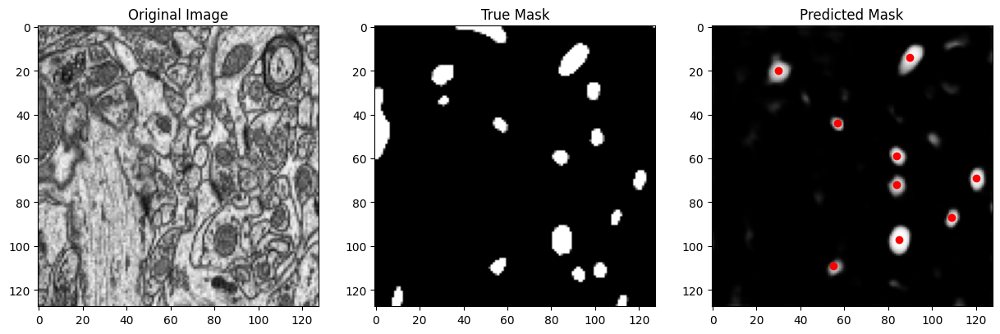

Centroids of predicted mask 46: [(90, 14), (30, 20), (57, 44), (84, 59), (120, 69), (84, 72), (109, 87), (85, 97), (55, 109)]


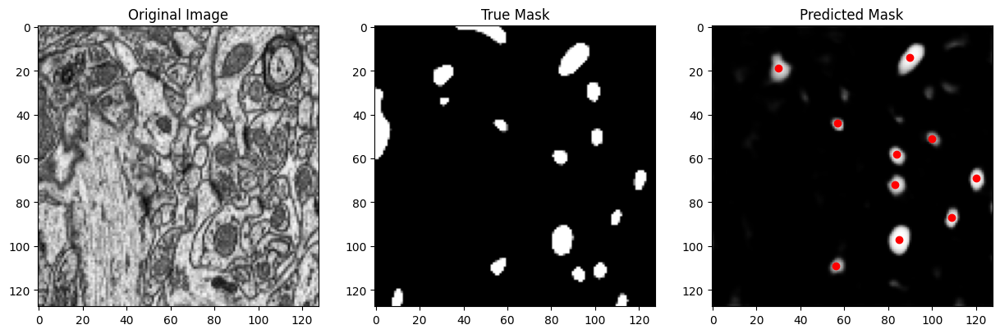

Centroids of predicted mask 47: [(90, 14), (30, 19), (57, 44), (100, 51), (84, 58), (120, 69), (83, 72), (109, 87), (85, 97), (56, 109)]


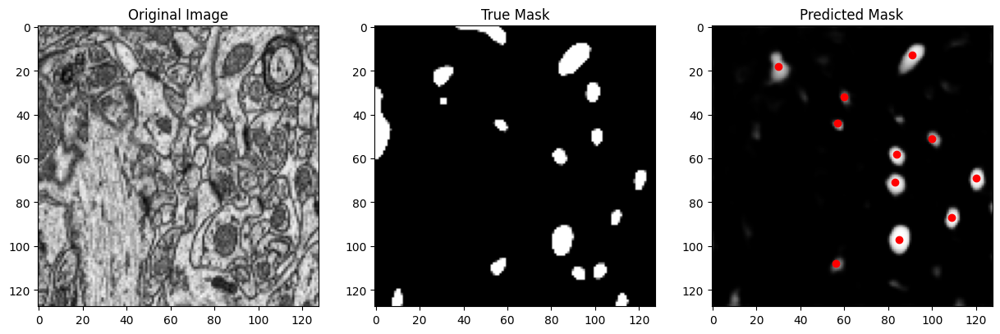

Centroids of predicted mask 48: [(91, 13), (30, 18), (60, 32), (57, 44), (100, 51), (84, 58), (120, 69), (83, 71), (109, 87), (85, 97), (56, 108)]


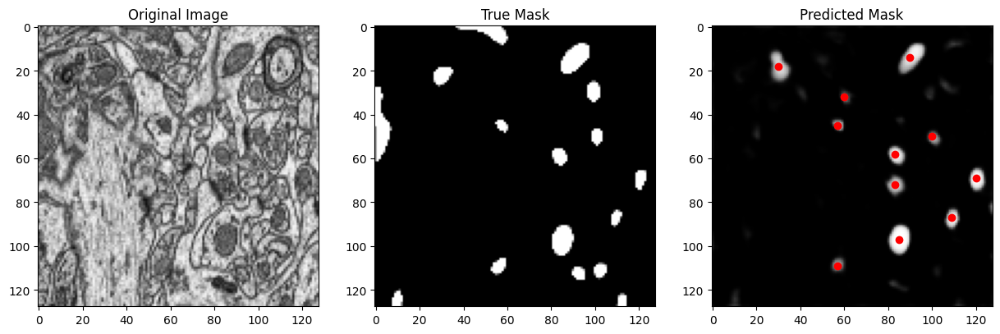

Centroids of predicted mask 49: [(90, 14), (30, 18), (60, 32), (57, 45), (100, 50), (83, 58), (120, 69), (83, 72), (109, 87), (85, 97), (57, 109)]


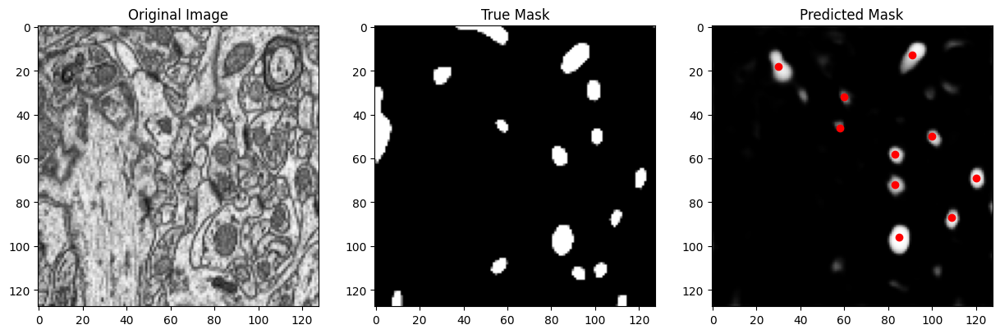

Centroids of predicted mask 50: [(91, 13), (30, 18), (60, 32), (58, 46), (100, 50), (83, 58), (120, 69), (83, 72), (109, 87), (85, 96)]


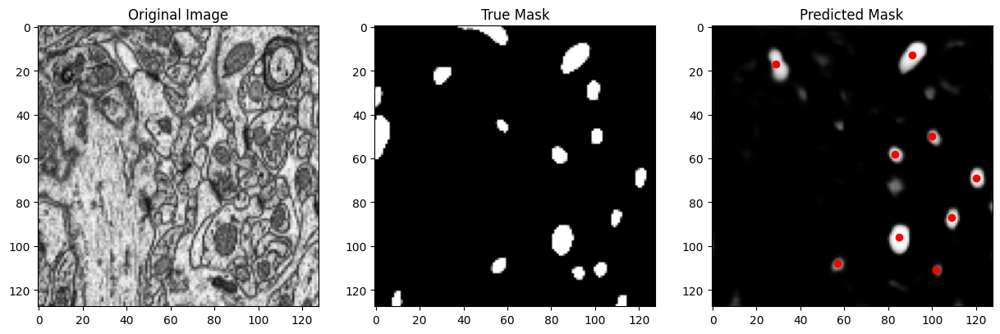

Centroids of predicted mask 51: [(91, 13), (29, 17), (100, 50), (83, 58), (120, 69), (109, 87), (85, 96), (57, 108), (102, 111)]


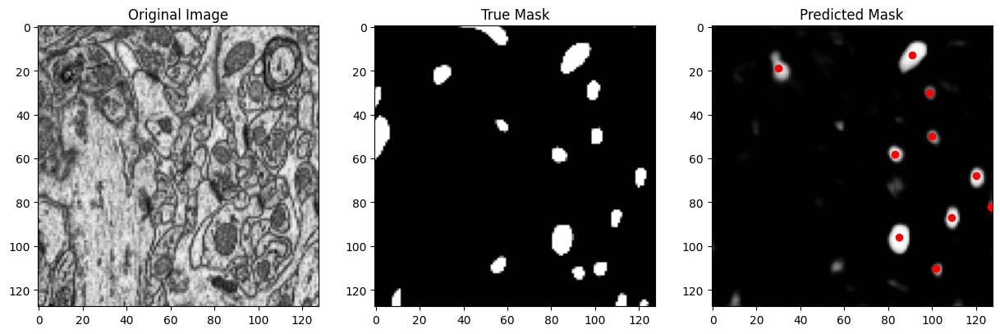

Centroids of predicted mask 52: [(91, 13), (30, 19), (99, 30), (100, 50), (83, 58), (120, 68), (127, 82), (109, 87), (85, 96), (102, 110)]


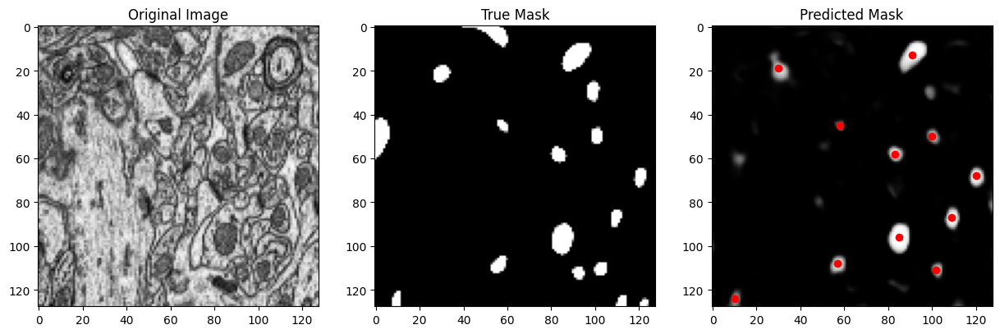

Centroids of predicted mask 53: [(91, 13), (30, 19), (58, 45), (100, 50), (83, 58), (120, 68), (109, 87), (85, 96), (57, 108), (102, 111), (10, 124)]


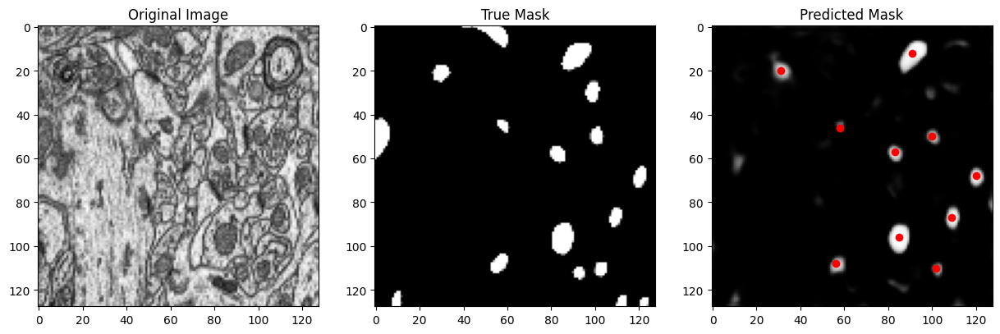

Centroids of predicted mask 54: [(91, 12), (31, 20), (58, 46), (100, 50), (83, 57), (120, 68), (109, 87), (85, 96), (56, 108), (102, 110)]


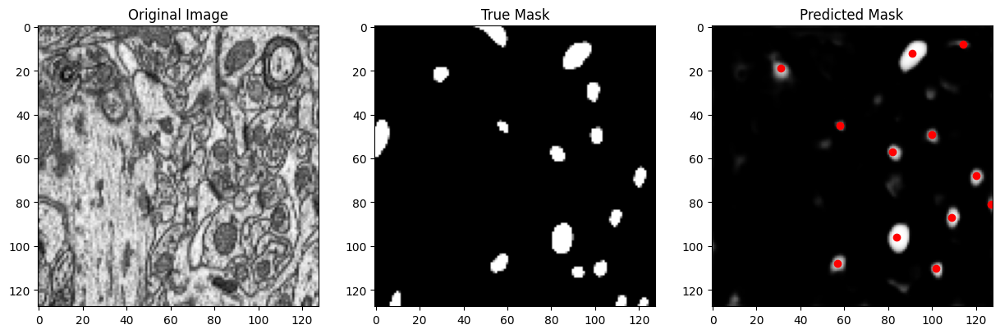

Centroids of predicted mask 55: [(91, 12), (114, 8), (31, 19), (58, 45), (100, 49), (82, 57), (120, 68), (127, 81), (109, 87), (84, 96), (57, 108), (102, 110)]


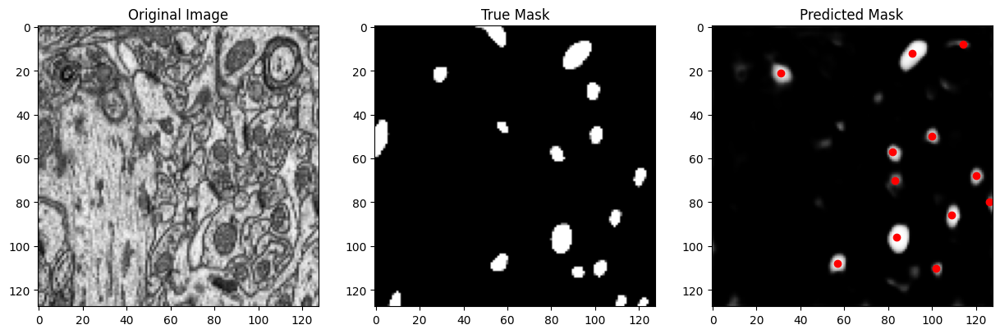

Centroids of predicted mask 56: [(91, 12), (114, 8), (31, 21), (100, 50), (82, 57), (120, 68), (83, 70), (126, 80), (109, 86), (84, 96), (57, 108), (102, 110)]


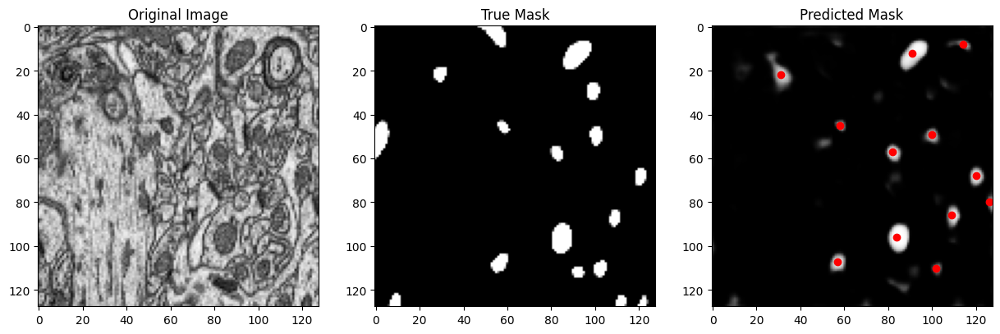

Centroids of predicted mask 57: [(91, 12), (114, 8), (31, 22), (58, 45), (100, 49), (82, 57), (120, 68), (126, 80), (109, 86), (84, 96), (57, 107), (102, 110)]


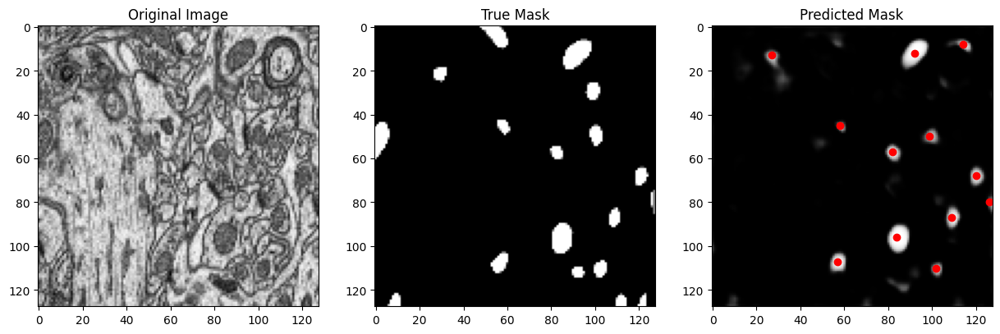

Centroids of predicted mask 58: [(92, 12), (114, 8), (27, 13), (58, 45), (99, 50), (82, 57), (120, 68), (126, 80), (109, 87), (84, 96), (57, 107), (102, 110)]


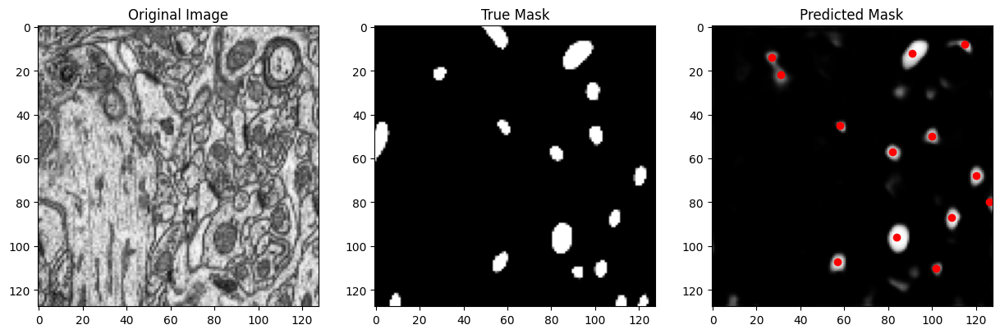

Centroids of predicted mask 59: [(91, 12), (115, 8), (27, 14), (31, 22), (58, 45), (100, 50), (82, 57), (120, 68), (126, 80), (109, 87), (84, 96), (57, 107), (102, 110)]


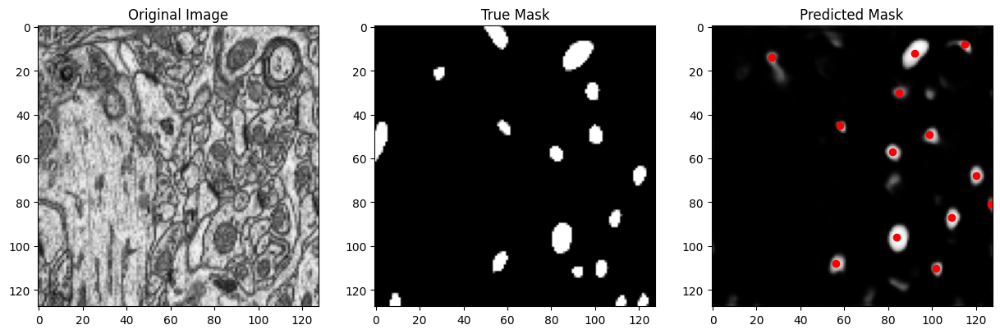

Centroids of predicted mask 60: [(92, 12), (115, 8), (27, 14), (85, 30), (58, 45), (99, 49), (82, 57), (120, 68), (127, 81), (109, 87), (84, 96), (56, 108), (102, 110)]


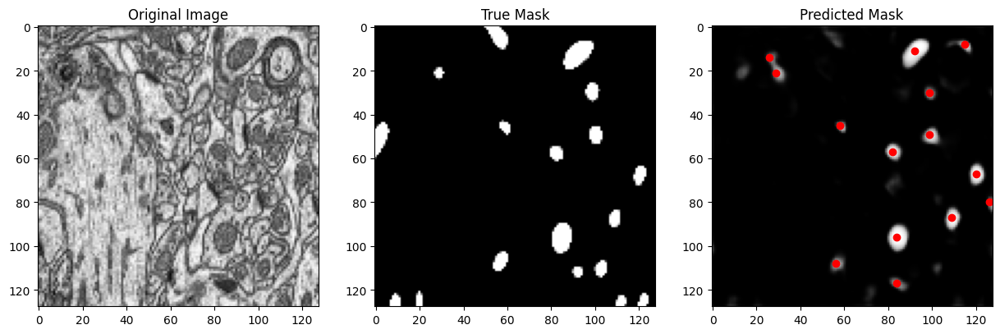

Centroids of predicted mask 61: [(92, 11), (115, 8), (26, 14), (29, 21), (99, 30), (58, 45), (99, 49), (82, 57), (120, 67), (126, 80), (109, 87), (84, 96), (56, 108), (84, 117)]


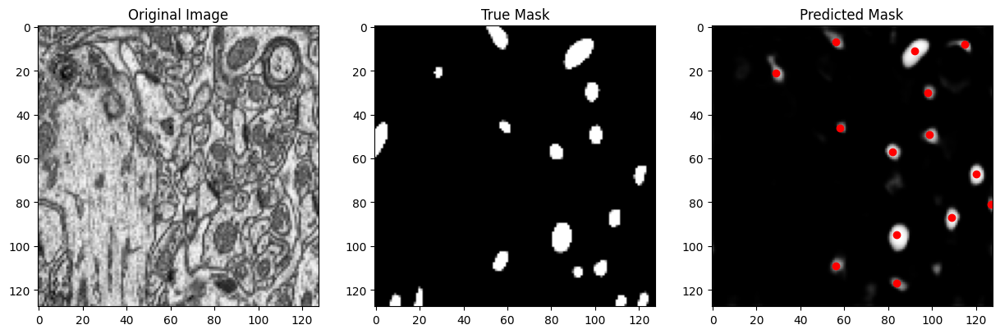

Centroids of predicted mask 62: [(56, 7), (92, 11), (115, 8), (29, 21), (98, 30), (58, 46), (99, 49), (82, 57), (120, 67), (127, 81), (109, 87), (84, 95), (56, 109), (84, 117)]


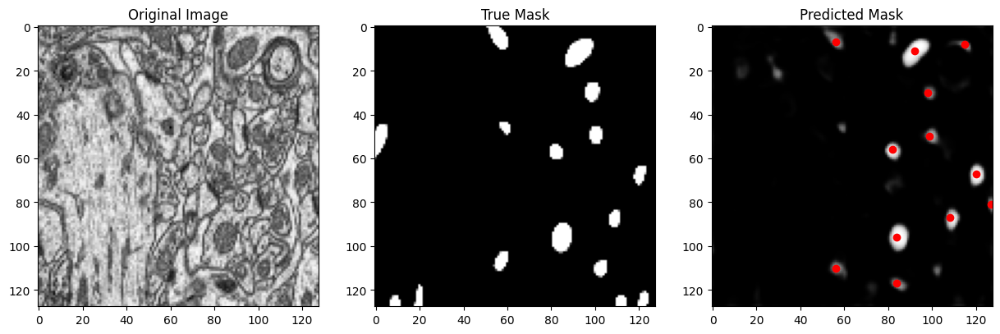

Centroids of predicted mask 63: [(56, 7), (92, 11), (115, 8), (98, 30), (99, 50), (82, 56), (120, 67), (127, 81), (108, 87), (84, 96), (56, 110), (84, 117)]


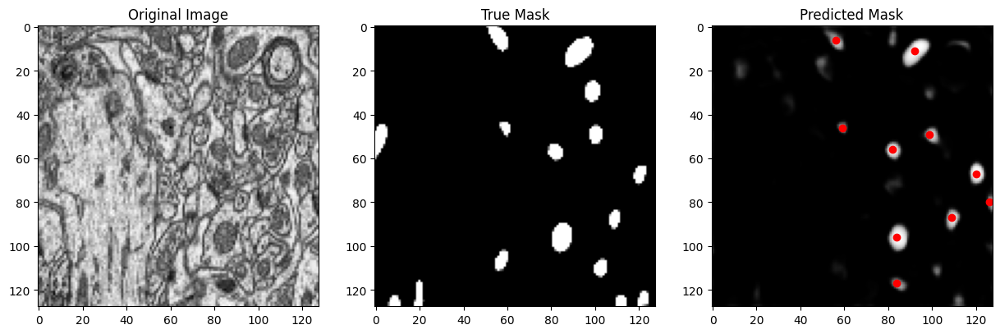

Centroids of predicted mask 64: [(56, 6), (92, 11), (59, 46), (99, 49), (82, 56), (120, 67), (126, 80), (109, 87), (84, 96), (84, 117)]


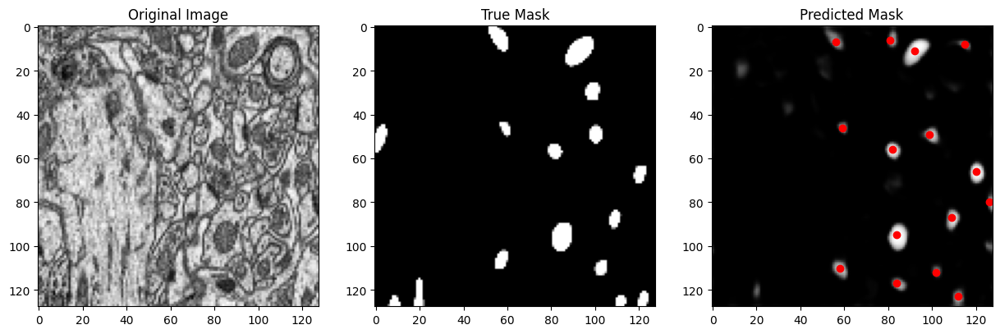

Centroids of predicted mask 65: [(81, 6), (56, 7), (92, 11), (115, 8), (59, 46), (99, 49), (82, 56), (120, 66), (126, 80), (109, 87), (84, 95), (58, 110), (102, 112), (84, 117), (112, 123)]


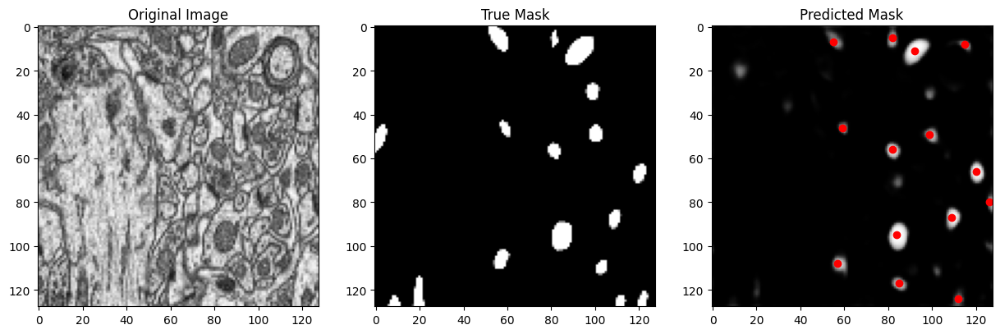

Centroids of predicted mask 66: [(82, 5), (55, 7), (92, 11), (115, 8), (59, 46), (99, 49), (82, 56), (120, 66), (126, 80), (109, 87), (84, 95), (57, 108), (85, 117), (112, 124)]


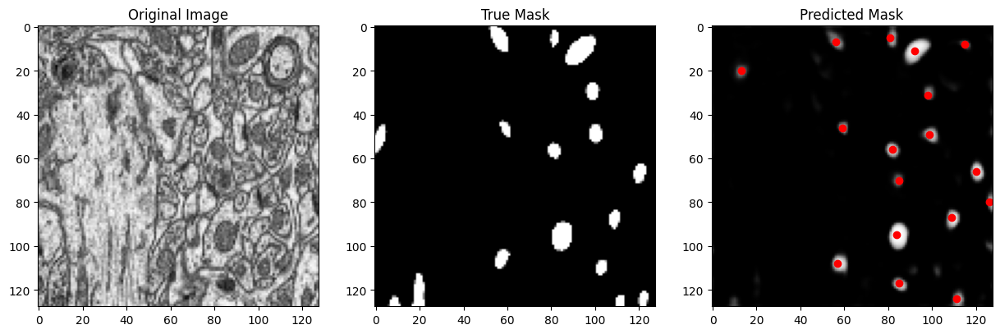

Centroids of predicted mask 67: [(81, 5), (56, 7), (92, 11), (115, 8), (13, 20), (98, 31), (59, 46), (99, 49), (82, 56), (120, 66), (85, 70), (126, 80), (109, 87), (84, 95), (57, 108), (85, 117), (111, 124)]


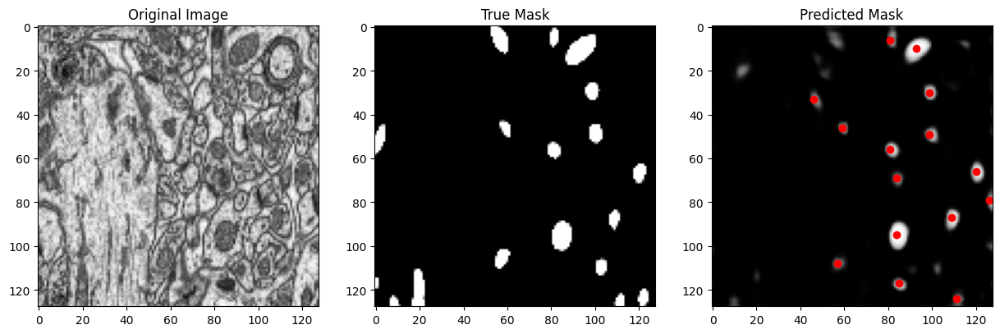

Centroids of predicted mask 68: [(81, 6), (93, 10), (99, 30), (46, 33), (59, 46), (99, 49), (81, 56), (120, 66), (84, 69), (126, 79), (109, 87), (84, 95), (57, 108), (85, 117), (111, 124)]


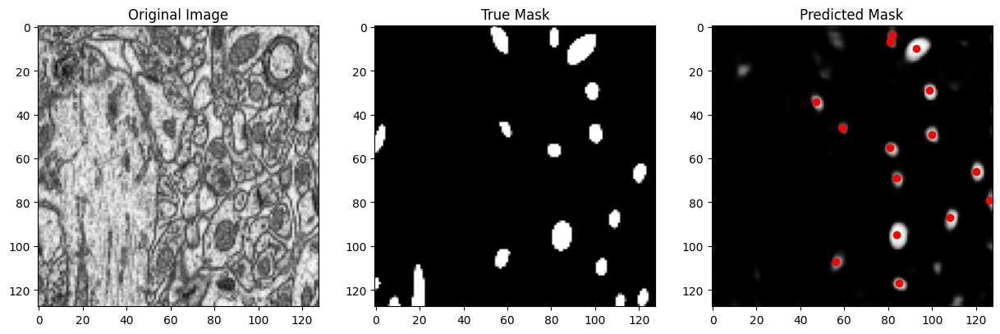

Centroids of predicted mask 69: [(82, 4), (93, 10), (81, 7), (99, 29), (47, 34), (59, 46), (100, 49), (81, 55), (120, 66), (84, 69), (126, 79), (108, 87), (84, 95), (56, 107), (85, 117)]


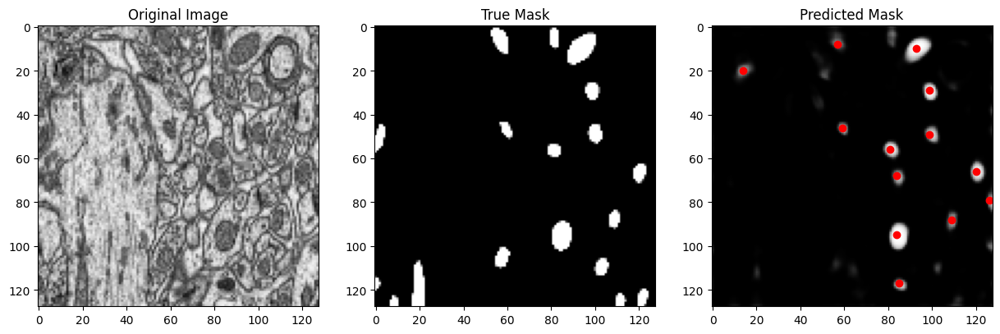

Centroids of predicted mask 70: [(93, 10), (57, 8), (14, 20), (99, 29), (59, 46), (99, 49), (81, 56), (120, 66), (84, 68), (126, 79), (109, 88), (84, 95), (85, 117)]


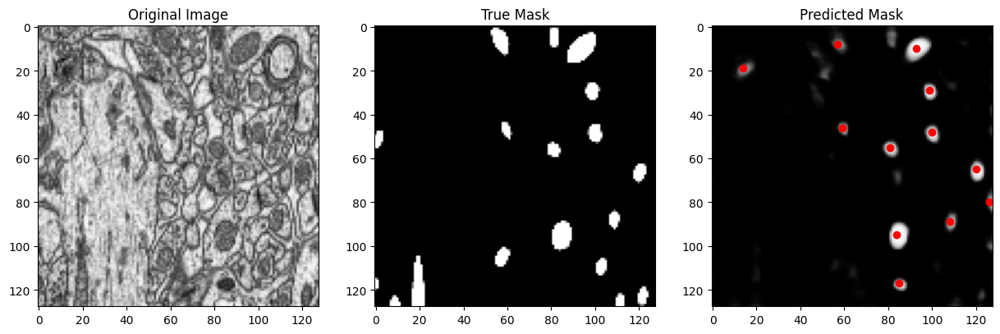

Centroids of predicted mask 71: [(93, 10), (57, 8), (14, 19), (99, 29), (59, 46), (100, 48), (81, 55), (120, 65), (126, 80), (108, 89), (84, 95), (85, 117)]


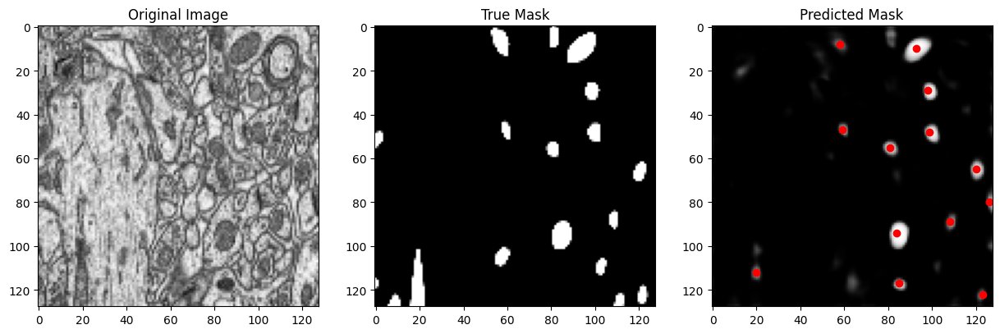

Centroids of predicted mask 72: [(93, 10), (58, 8), (98, 29), (59, 47), (99, 48), (81, 55), (120, 65), (126, 80), (108, 89), (84, 94), (20, 112), (85, 117), (123, 122)]


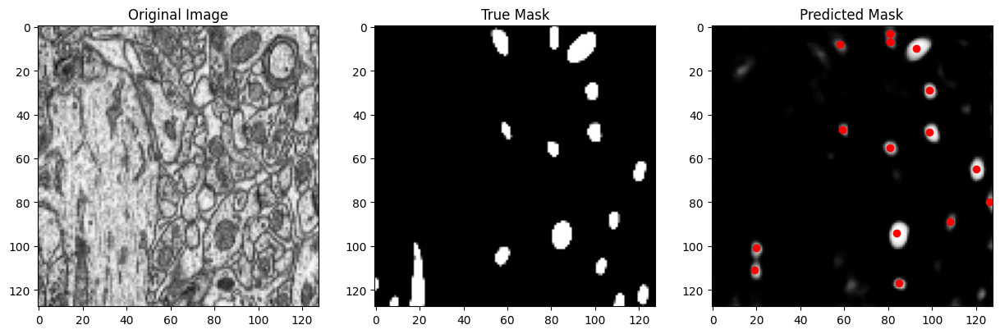

Centroids of predicted mask 73: [(81, 3), (93, 10), (81, 7), (58, 8), (99, 29), (99, 48), (59, 47), (81, 55), (120, 65), (126, 80), (108, 89), (84, 94), (20, 101), (19, 111), (85, 117)]


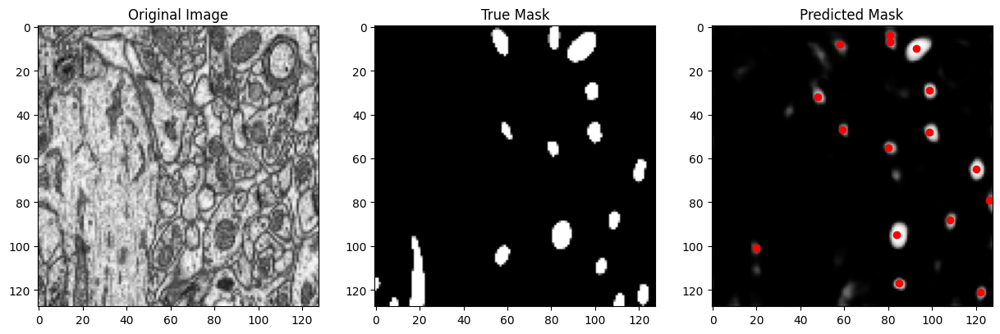

Centroids of predicted mask 74: [(81, 4), (81, 7), (93, 10), (58, 8), (99, 29), (48, 32), (99, 48), (59, 47), (80, 55), (120, 65), (126, 79), (108, 88), (84, 95), (20, 101), (85, 117), (122, 121)]


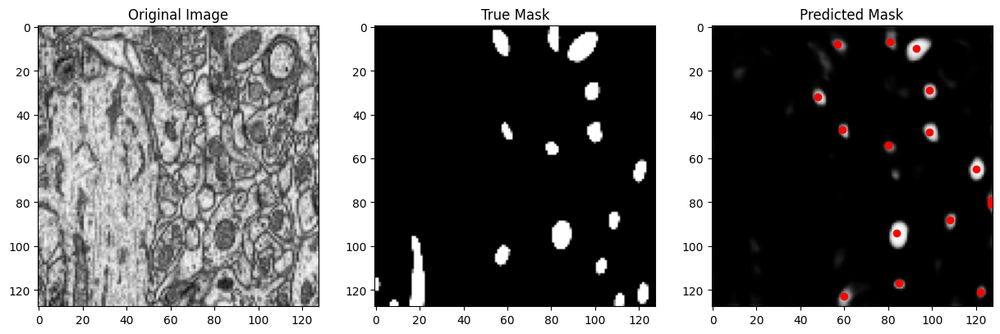

Centroids of predicted mask 75: [(93, 10), (57, 8), (81, 7), (99, 29), (48, 32), (99, 48), (59, 47), (80, 54), (120, 65), (127, 79), (127, 81), (108, 88), (84, 94), (85, 117), (122, 121), (60, 123)]


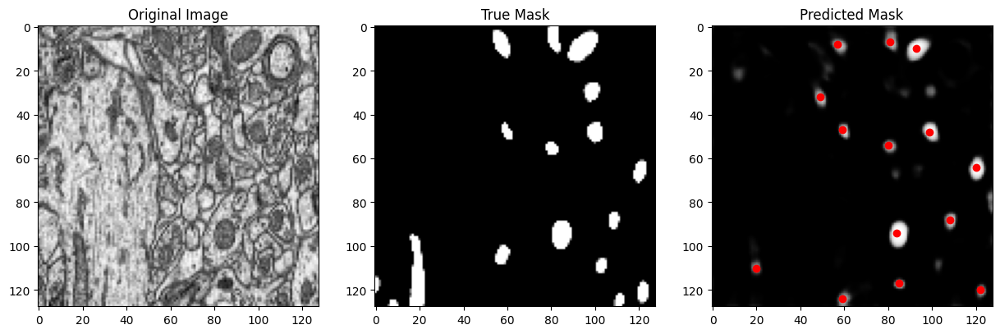

Centroids of predicted mask 76: [(81, 7), (93, 10), (57, 8), (49, 32), (59, 47), (99, 48), (80, 54), (120, 64), (108, 88), (84, 94), (20, 110), (85, 117), (122, 120), (59, 124)]


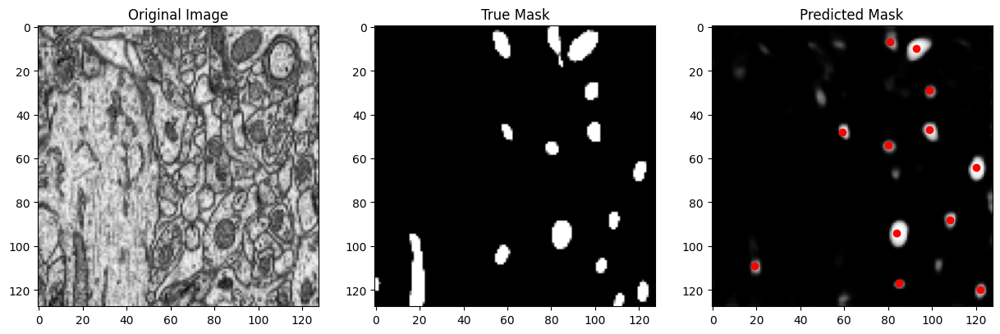

Centroids of predicted mask 77: [(81, 7), (93, 10), (99, 29), (99, 47), (59, 48), (80, 54), (120, 64), (108, 88), (84, 94), (19, 109), (85, 117), (122, 120)]


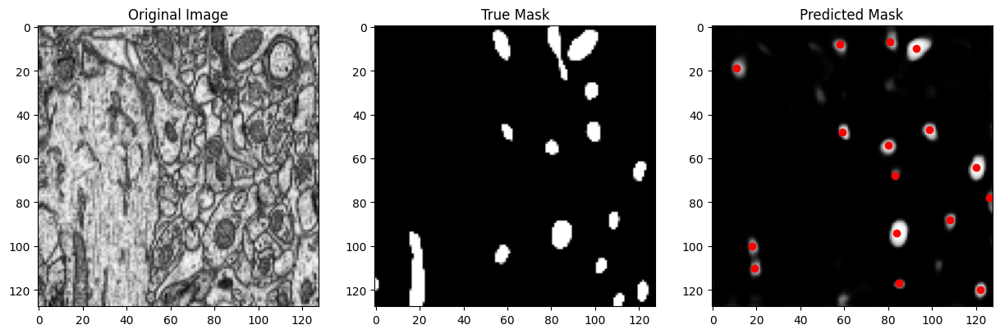

Centroids of predicted mask 78: [(81, 7), (93, 10), (58, 8), (11, 19), (99, 47), (59, 48), (80, 54), (120, 64), (83, 68), (126, 78), (108, 88), (84, 94), (18, 100), (19, 110), (85, 117), (122, 120)]


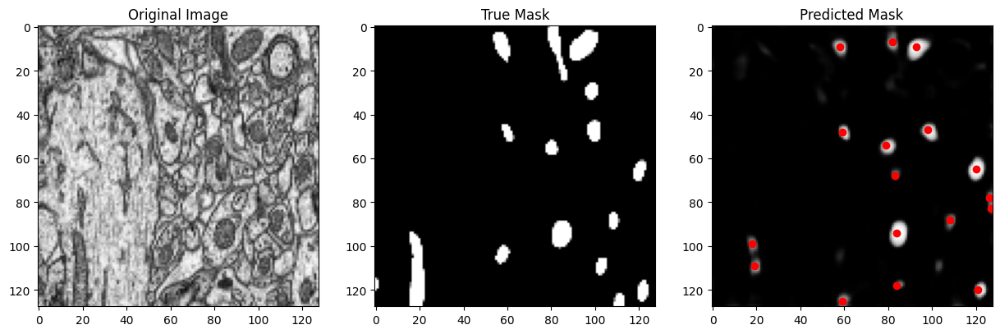

Centroids of predicted mask 79: [(82, 7), (93, 9), (58, 9), (98, 47), (59, 48), (79, 54), (120, 65), (83, 68), (126, 78), (127, 83), (108, 88), (84, 94), (18, 99), (19, 109), (84, 118), (121, 120), (59, 125)]


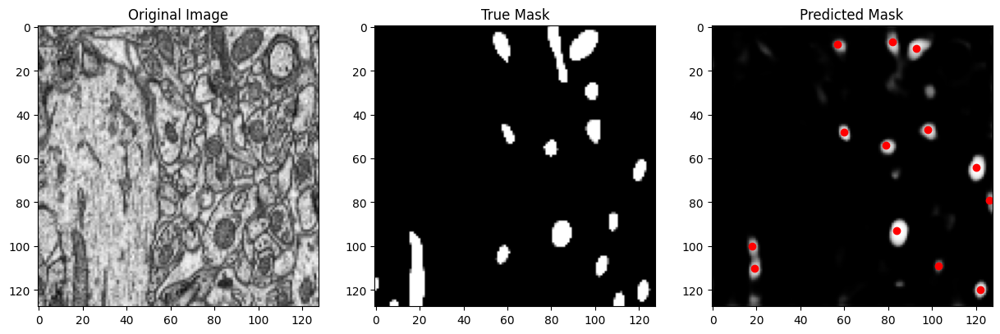

Centroids of predicted mask 80: [(82, 7), (57, 8), (93, 10), (98, 47), (60, 48), (79, 54), (120, 64), (126, 79), (84, 93), (18, 100), (19, 110), (103, 109), (122, 120)]


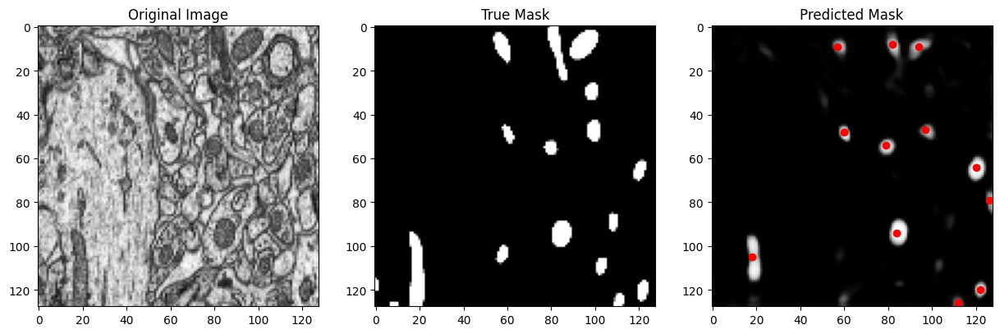

Centroids of predicted mask 81: [(82, 8), (57, 9), (94, 9), (60, 48), (97, 47), (79, 54), (120, 64), (126, 79), (84, 94), (18, 105), (122, 120), (112, 126)]


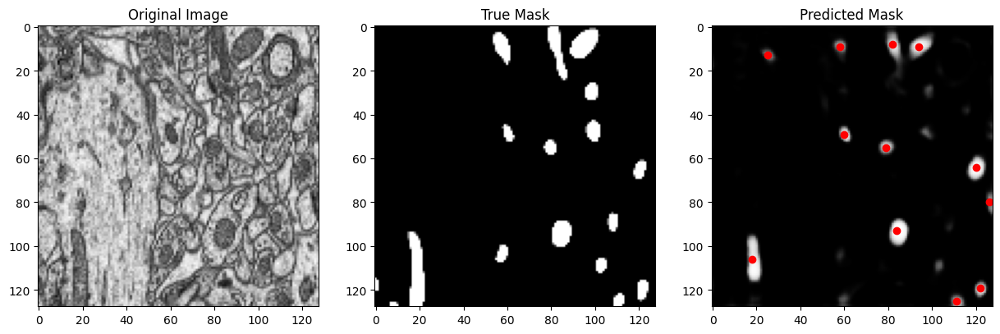

Centroids of predicted mask 82: [(82, 8), (94, 9), (58, 9), (25, 13), (60, 49), (79, 55), (120, 64), (126, 80), (84, 93), (18, 106), (122, 119), (111, 125)]


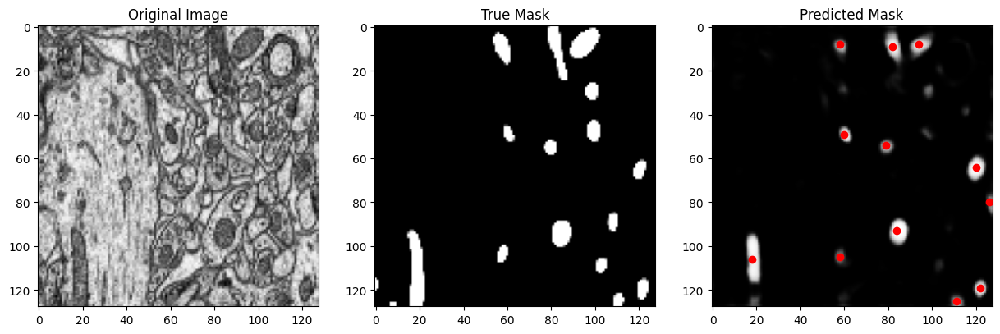

Centroids of predicted mask 83: [(82, 9), (94, 8), (58, 8), (60, 49), (79, 54), (120, 64), (126, 80), (84, 93), (18, 106), (58, 105), (122, 119), (111, 125)]


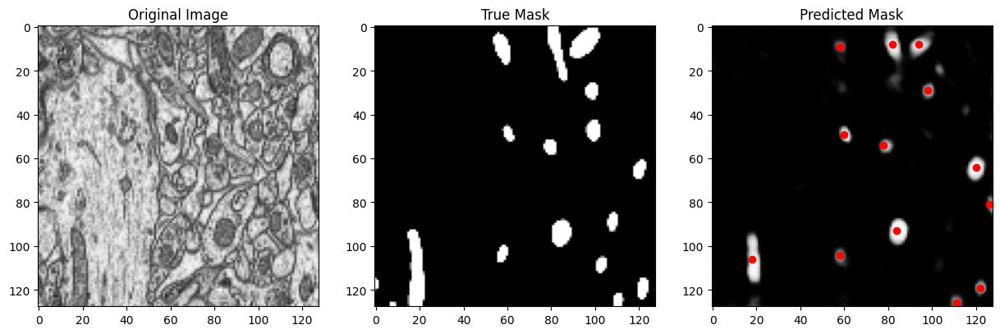

Centroids of predicted mask 84: [(82, 8), (94, 8), (58, 9), (98, 29), (60, 49), (78, 54), (120, 64), (126, 81), (84, 93), (18, 106), (58, 104), (122, 119), (111, 126)]


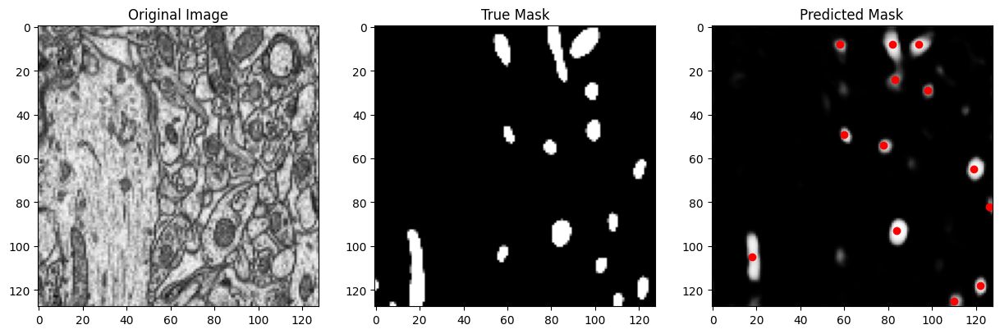

Centroids of predicted mask 85: [(82, 8), (94, 8), (58, 8), (83, 24), (98, 29), (60, 49), (78, 54), (119, 65), (126, 82), (84, 93), (18, 105), (122, 118), (110, 125)]


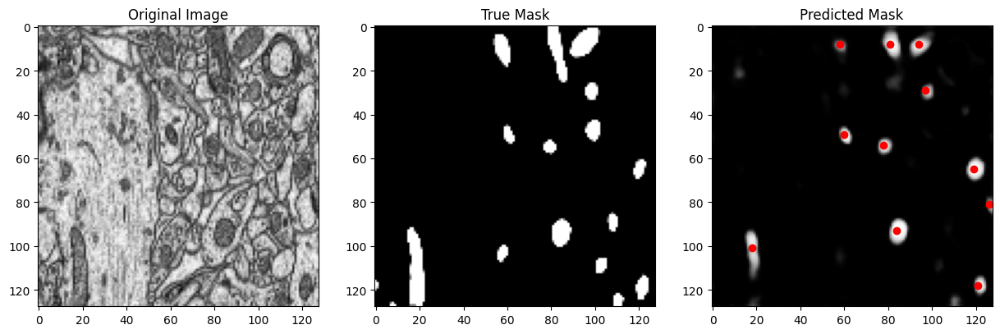

Centroids of predicted mask 86: [(81, 8), (94, 8), (58, 8), (97, 29), (60, 49), (78, 54), (119, 65), (126, 81), (84, 93), (18, 101), (121, 118)]


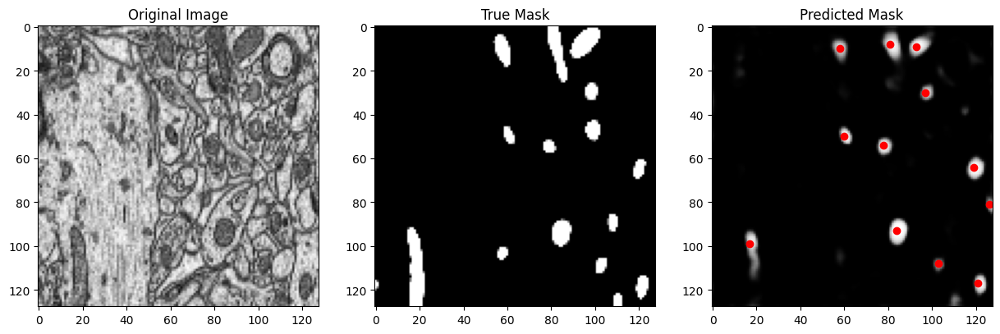

Centroids of predicted mask 87: [(81, 8), (93, 9), (58, 10), (97, 30), (60, 50), (78, 54), (119, 64), (126, 81), (84, 93), (17, 99), (103, 108), (121, 117)]


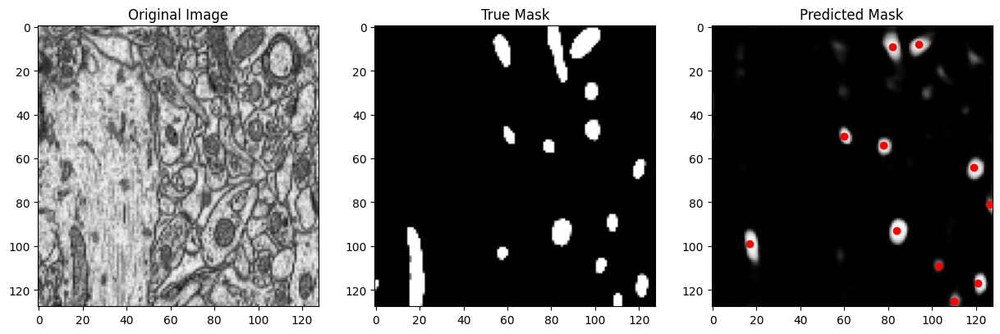

Centroids of predicted mask 88: [(82, 9), (94, 8), (60, 50), (78, 54), (119, 64), (126, 81), (84, 93), (17, 99), (103, 109), (121, 117), (110, 125)]


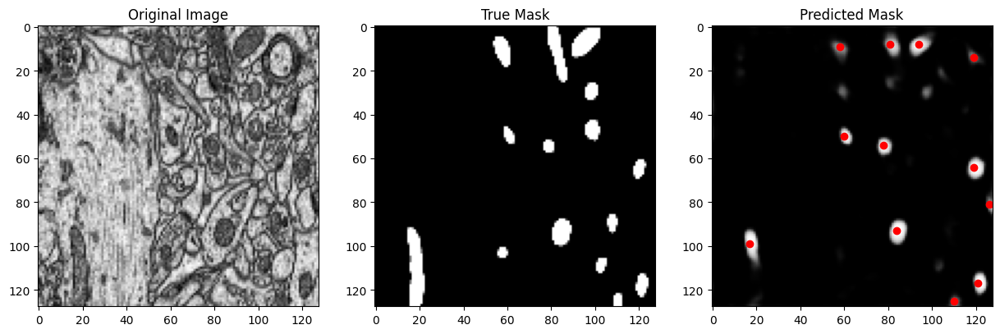

Centroids of predicted mask 89: [(81, 8), (94, 8), (58, 9), (119, 14), (60, 50), (78, 54), (119, 64), (126, 81), (84, 93), (17, 99), (121, 117), (110, 125)]


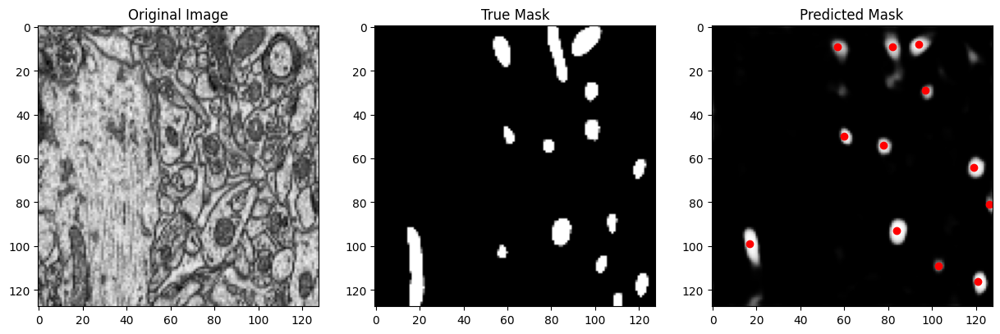

Centroids of predicted mask 90: [(82, 9), (94, 8), (57, 9), (97, 29), (60, 50), (78, 54), (119, 64), (126, 81), (84, 93), (17, 99), (103, 109), (121, 116)]


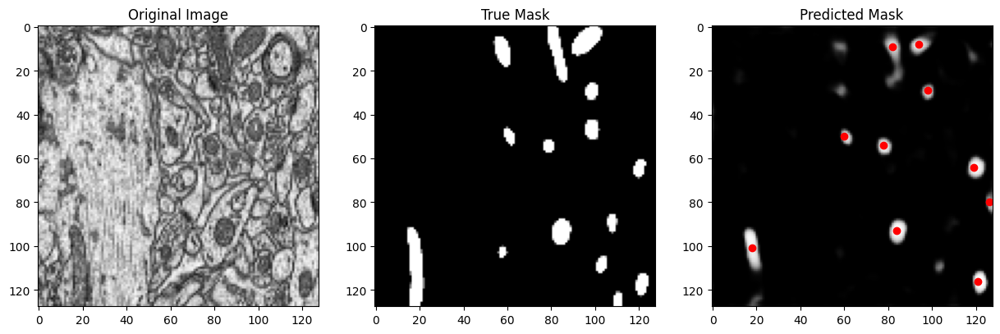

Centroids of predicted mask 91: [(82, 9), (94, 8), (98, 29), (60, 50), (78, 54), (119, 64), (126, 80), (84, 93), (18, 101), (121, 116)]


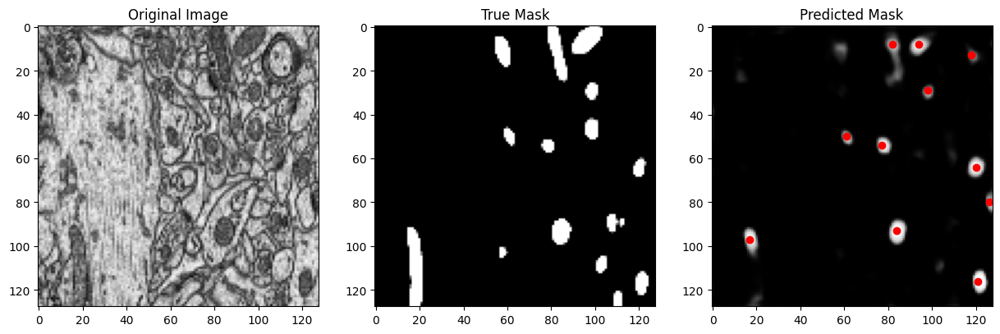

Centroids of predicted mask 92: [(82, 8), (94, 8), (118, 13), (98, 29), (61, 50), (77, 54), (120, 64), (126, 80), (84, 93), (17, 97), (121, 116)]


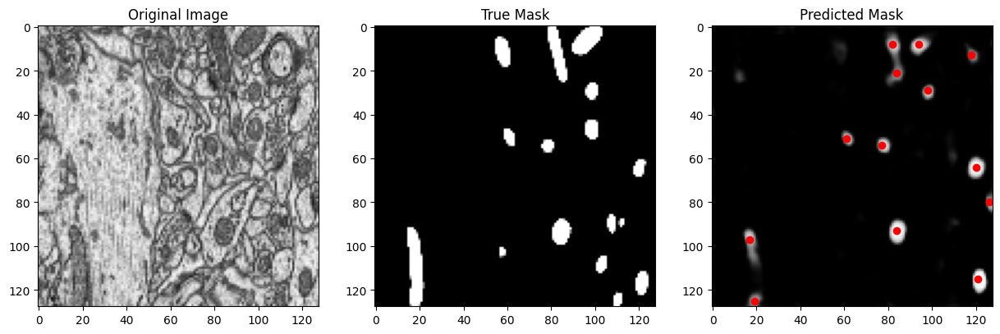

Centroids of predicted mask 93: [(82, 8), (94, 8), (118, 13), (84, 21), (98, 29), (61, 51), (77, 54), (120, 64), (126, 80), (84, 93), (17, 97), (121, 115), (19, 125)]


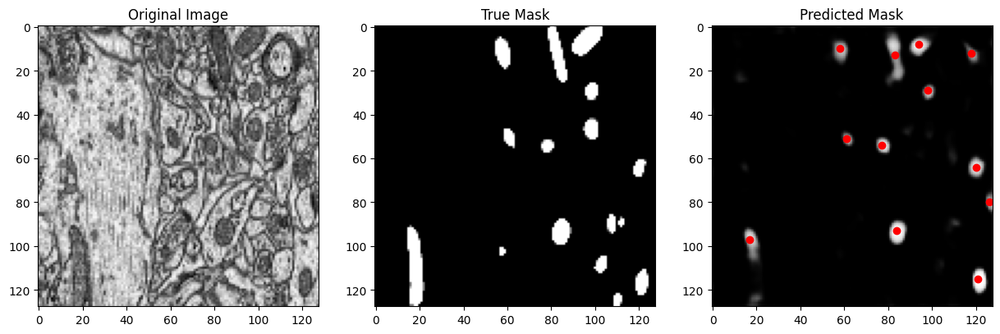

Centroids of predicted mask 94: [(83, 13), (94, 8), (58, 10), (118, 12), (98, 29), (61, 51), (77, 54), (120, 64), (126, 80), (84, 93), (17, 97), (121, 115)]


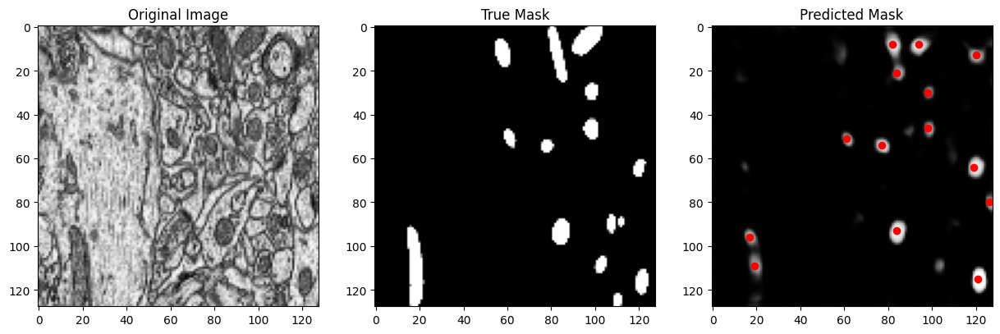

Centroids of predicted mask 95: [(82, 8), (94, 8), (120, 13), (84, 21), (98, 30), (98, 46), (61, 51), (77, 54), (119, 64), (126, 80), (84, 93), (17, 96), (19, 109), (121, 115)]


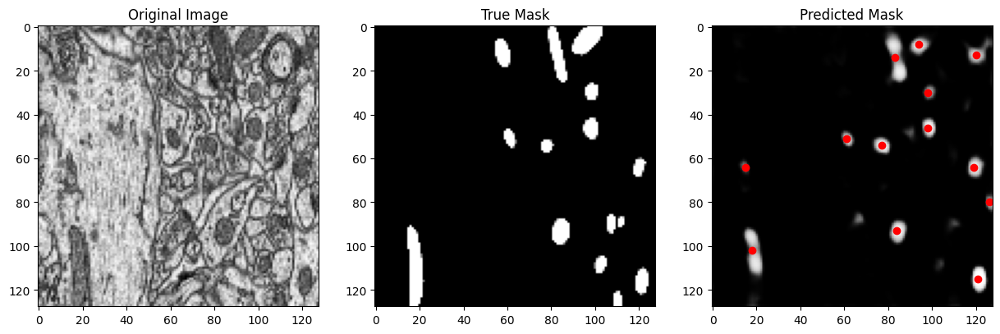

Centroids of predicted mask 96: [(83, 14), (94, 8), (120, 13), (98, 30), (98, 46), (61, 51), (77, 54), (119, 64), (15, 64), (126, 80), (84, 93), (18, 102), (121, 115)]


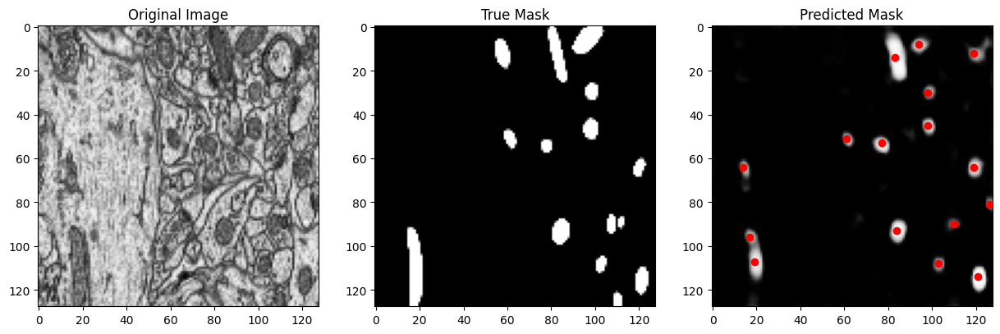

Centroids of predicted mask 97: [(83, 14), (94, 8), (119, 12), (98, 30), (98, 45), (61, 51), (77, 53), (119, 64), (14, 64), (126, 81), (84, 93), (110, 90), (17, 96), (19, 107), (103, 108), (121, 114)]


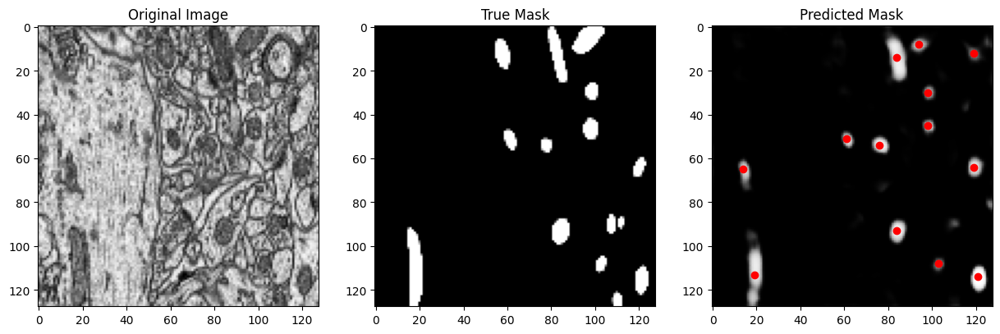

Centroids of predicted mask 98: [(84, 14), (94, 8), (119, 12), (98, 30), (98, 45), (61, 51), (76, 54), (119, 64), (14, 65), (84, 93), (19, 113), (103, 108), (121, 114)]


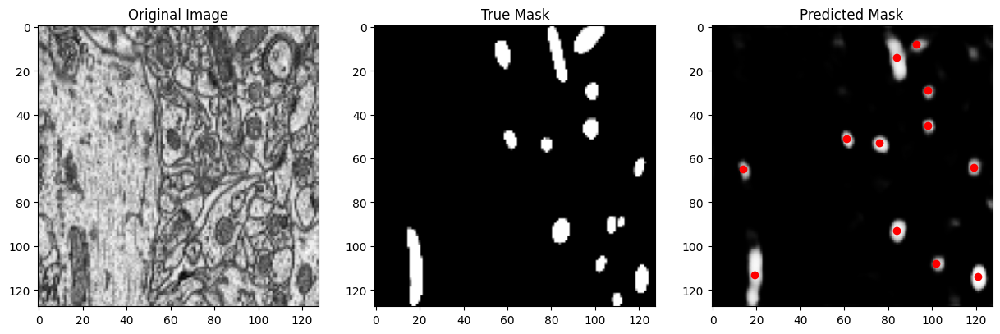

Centroids of predicted mask 99: [(84, 14), (93, 8), (98, 29), (98, 45), (61, 51), (76, 53), (119, 64), (14, 65), (84, 93), (19, 113), (102, 108), (121, 114)]


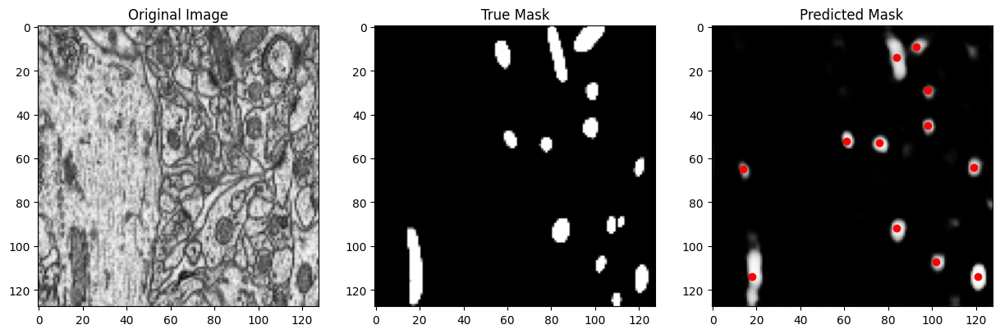

Centroids of predicted mask 100: [(84, 14), (93, 9), (98, 29), (98, 45), (61, 52), (76, 53), (119, 64), (14, 65), (84, 92), (18, 114), (102, 107), (121, 114)]


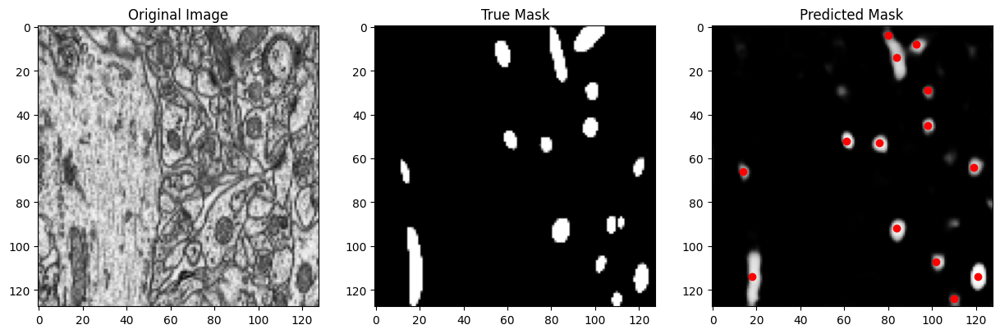

Centroids of predicted mask 101: [(80, 4), (84, 14), (93, 8), (98, 29), (98, 45), (61, 52), (76, 53), (119, 64), (14, 66), (84, 92), (18, 114), (102, 107), (121, 114), (110, 124)]


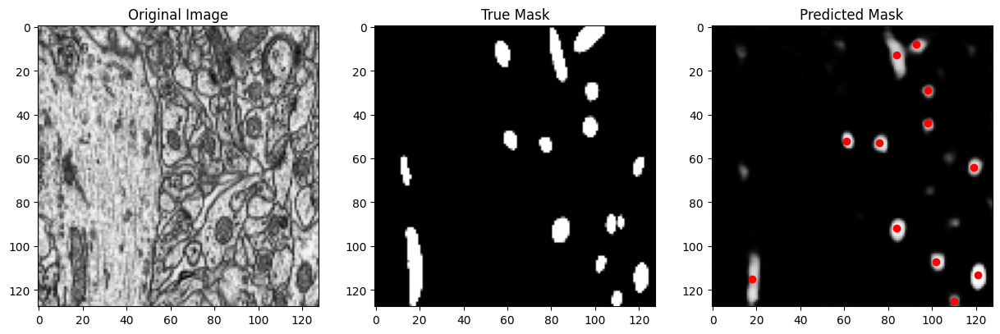

Centroids of predicted mask 102: [(84, 13), (93, 8), (98, 29), (98, 44), (61, 52), (76, 53), (119, 64), (84, 92), (102, 107), (18, 115), (121, 113), (110, 125)]


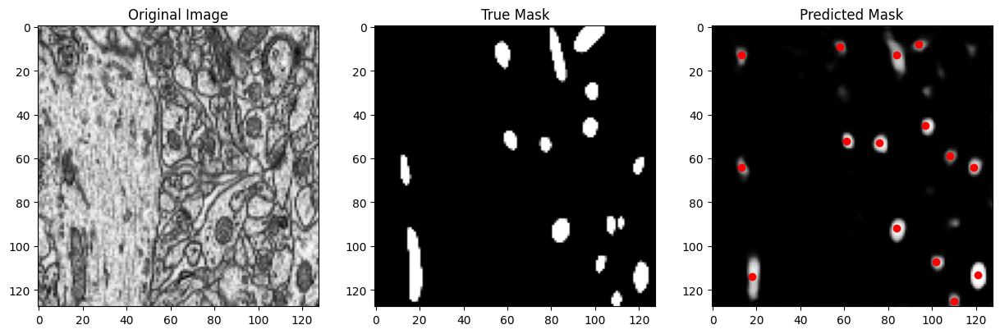

Centroids of predicted mask 103: [(58, 9), (84, 13), (94, 8), (13, 13), (97, 45), (61, 52), (76, 53), (108, 59), (119, 64), (13, 64), (84, 92), (18, 114), (102, 107), (121, 113), (110, 125)]


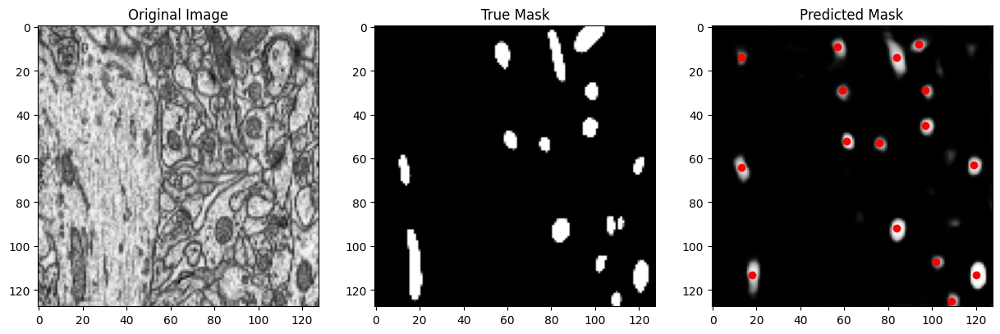

Centroids of predicted mask 104: [(57, 9), (94, 8), (84, 14), (13, 14), (59, 29), (97, 29), (97, 45), (61, 52), (76, 53), (13, 64), (119, 63), (84, 92), (102, 107), (18, 113), (120, 113), (109, 125)]


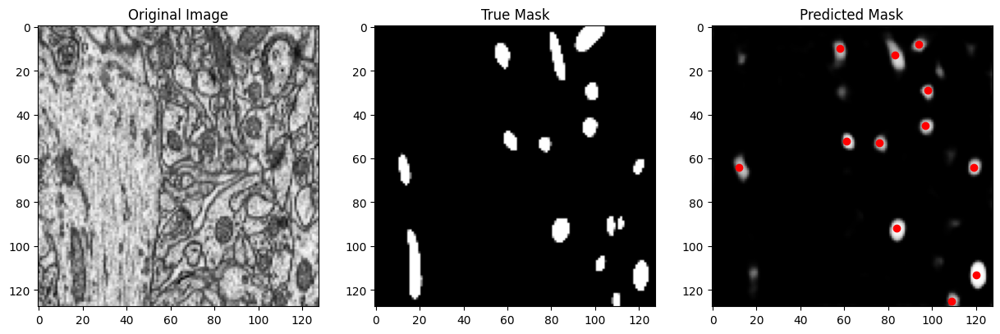

Centroids of predicted mask 105: [(94, 8), (58, 10), (83, 13), (98, 29), (97, 45), (61, 52), (76, 53), (12, 64), (119, 64), (84, 92), (120, 113), (109, 125)]


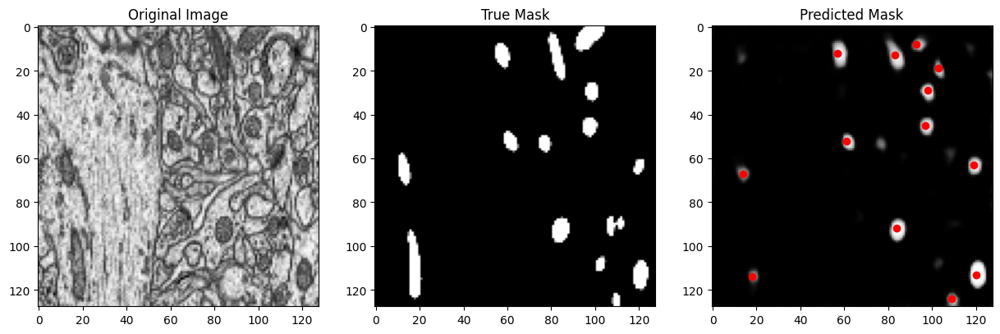

Centroids of predicted mask 106: [(93, 8), (57, 12), (83, 13), (103, 19), (98, 29), (97, 45), (61, 52), (119, 63), (14, 67), (84, 92), (120, 113), (18, 114), (109, 124)]


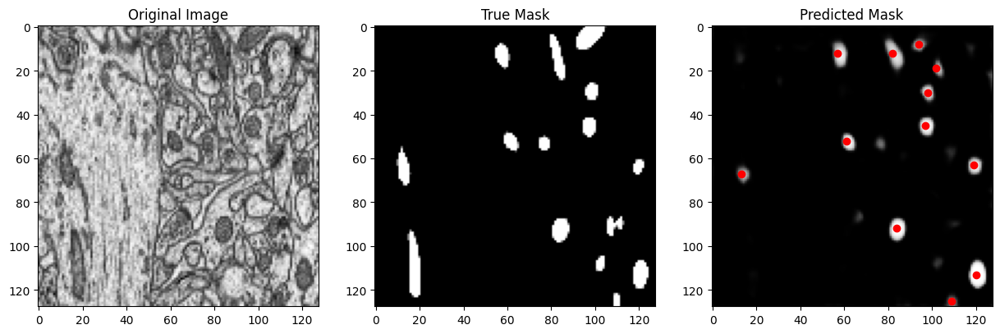

Centroids of predicted mask 107: [(82, 12), (94, 8), (57, 12), (102, 19), (98, 30), (97, 45), (61, 52), (119, 63), (13, 67), (84, 92), (120, 113), (109, 125)]


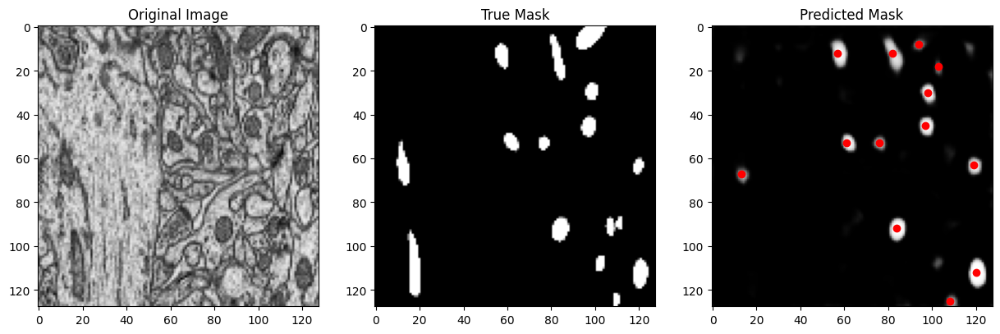

Centroids of predicted mask 108: [(82, 12), (57, 12), (94, 8), (103, 18), (98, 30), (97, 45), (61, 53), (76, 53), (119, 63), (13, 67), (84, 92), (120, 112), (108, 125)]


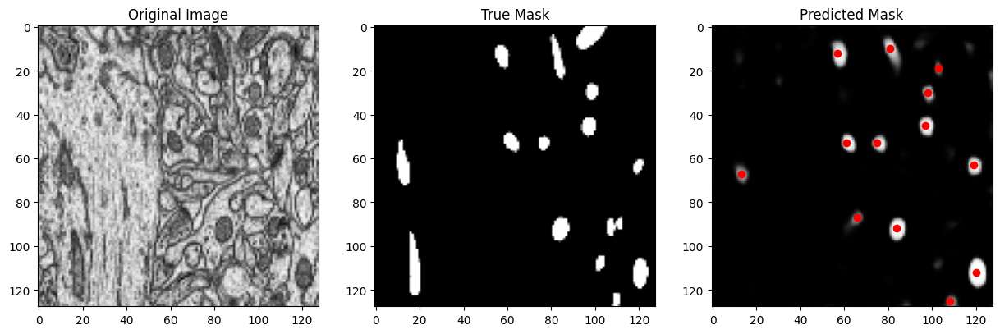

Centroids of predicted mask 109: [(81, 10), (57, 12), (103, 19), (98, 30), (97, 45), (61, 53), (75, 53), (119, 63), (13, 67), (66, 87), (84, 92), (120, 112), (108, 125)]


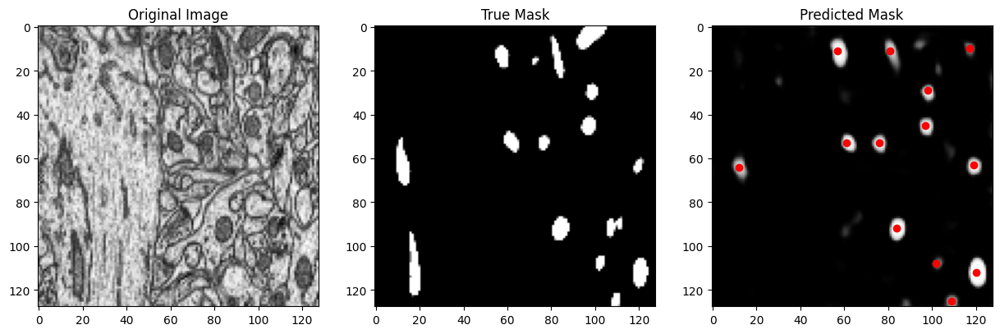

Centroids of predicted mask 110: [(57, 11), (81, 11), (117, 10), (98, 29), (97, 45), (61, 53), (76, 53), (12, 64), (119, 63), (84, 92), (120, 112), (102, 108), (109, 125)]


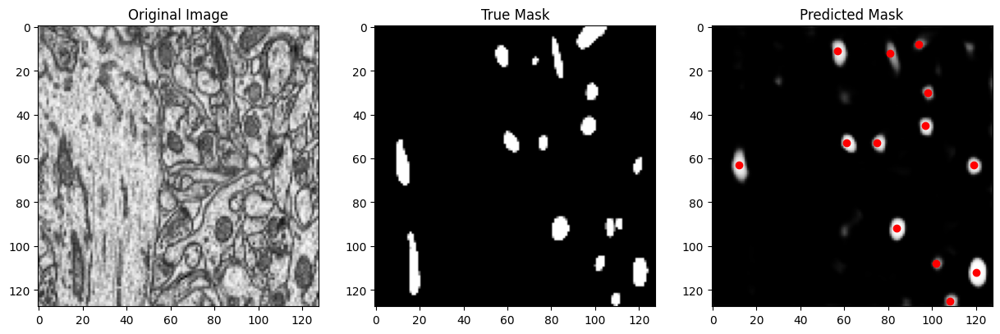

Centroids of predicted mask 111: [(57, 11), (94, 8), (81, 12), (98, 30), (97, 45), (61, 53), (75, 53), (12, 63), (119, 63), (84, 92), (120, 112), (102, 108), (108, 125)]


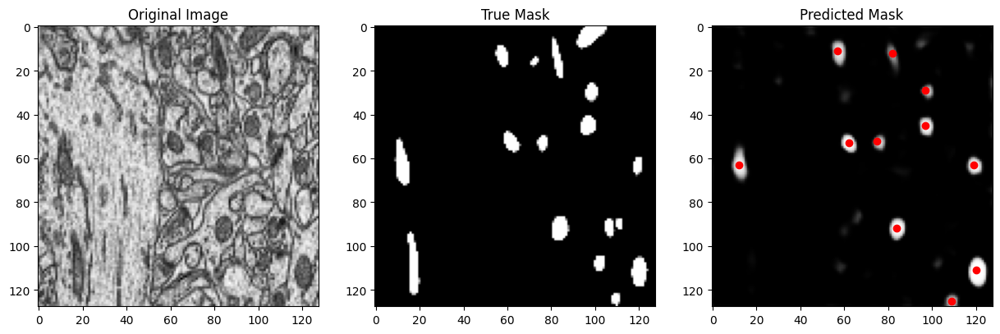

Centroids of predicted mask 112: [(57, 11), (82, 12), (97, 29), (97, 45), (62, 53), (75, 52), (12, 63), (119, 63), (84, 92), (120, 111), (109, 125)]


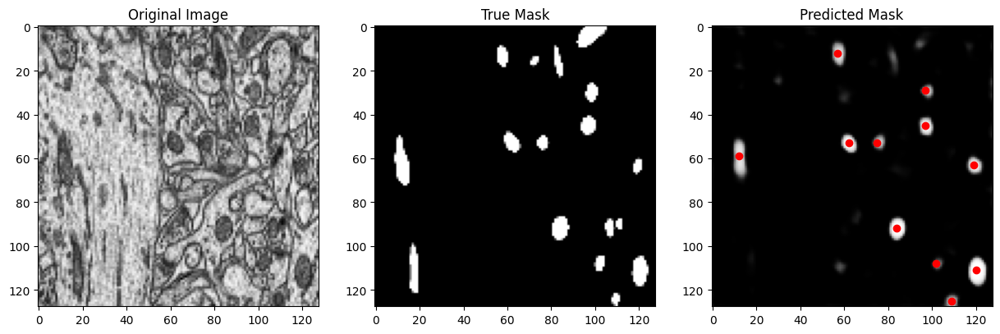

Centroids of predicted mask 113: [(57, 12), (97, 29), (97, 45), (62, 53), (75, 53), (12, 59), (119, 63), (84, 92), (120, 111), (102, 108), (109, 125)]


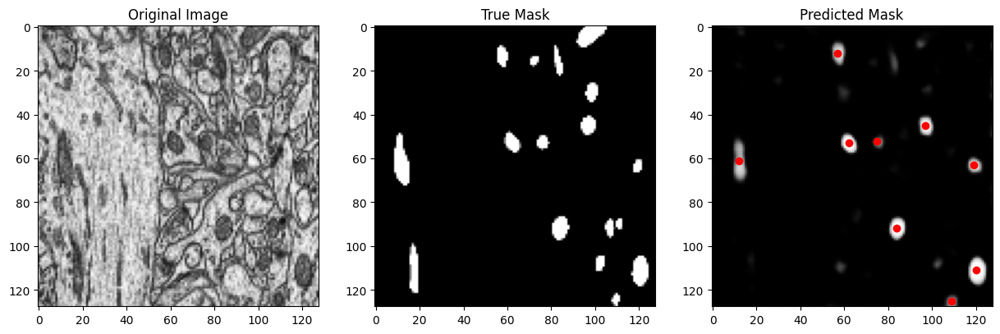

Centroids of predicted mask 114: [(57, 12), (97, 45), (62, 53), (75, 52), (12, 61), (119, 63), (84, 92), (120, 111), (109, 125)]


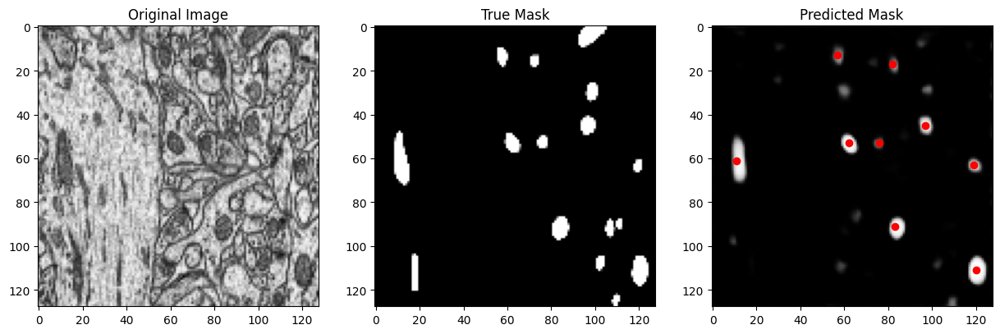

Centroids of predicted mask 115: [(57, 13), (82, 17), (97, 45), (62, 53), (11, 61), (76, 53), (119, 63), (83, 91), (120, 111)]


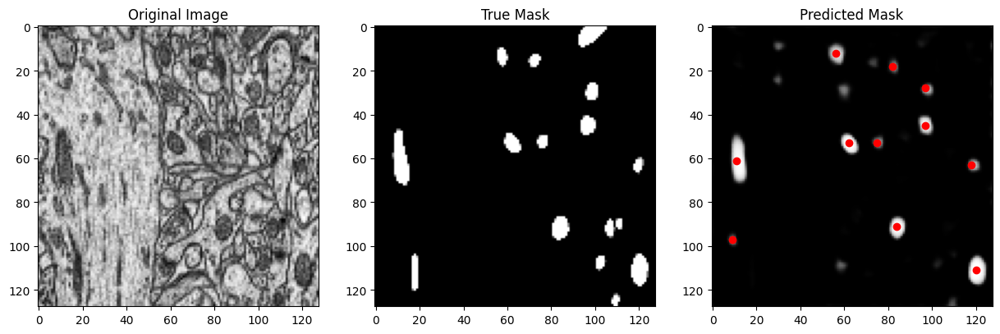

Centroids of predicted mask 116: [(56, 12), (82, 18), (97, 28), (97, 45), (62, 53), (11, 61), (75, 53), (118, 63), (84, 91), (9, 97), (120, 111)]


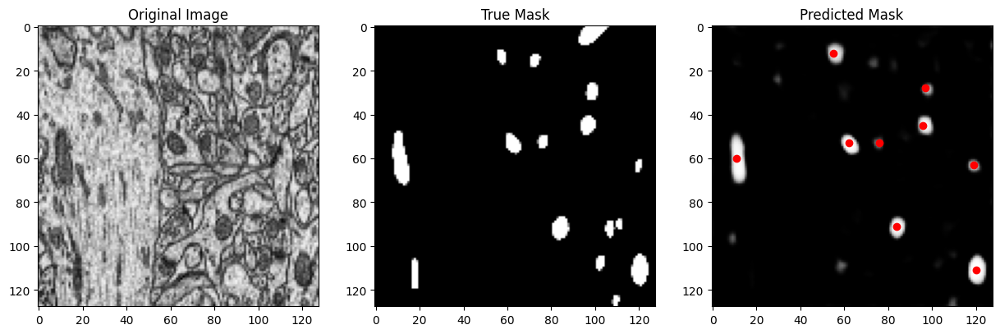

Centroids of predicted mask 117: [(55, 12), (97, 28), (96, 45), (11, 60), (62, 53), (76, 53), (119, 63), (84, 91), (120, 111)]


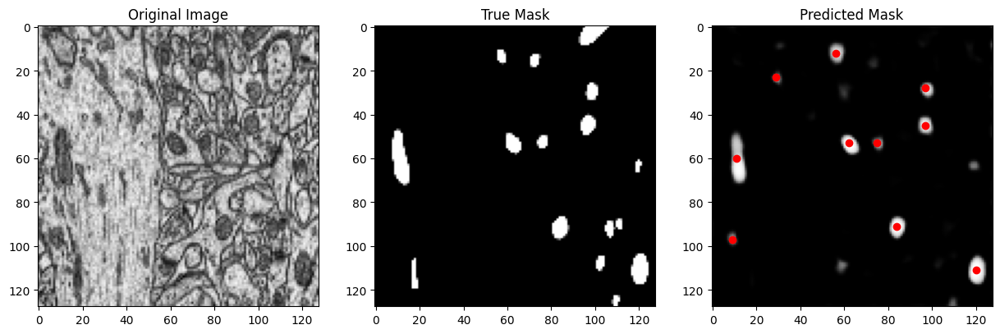

Centroids of predicted mask 118: [(56, 12), (29, 23), (97, 28), (97, 45), (11, 60), (62, 53), (75, 53), (84, 91), (9, 97), (120, 111)]


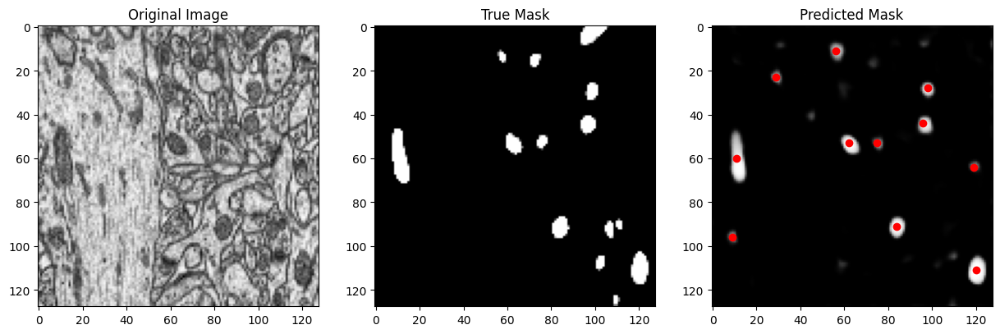

Centroids of predicted mask 119: [(56, 11), (29, 23), (98, 28), (96, 44), (11, 60), (62, 53), (75, 53), (119, 64), (84, 91), (9, 96), (120, 111)]


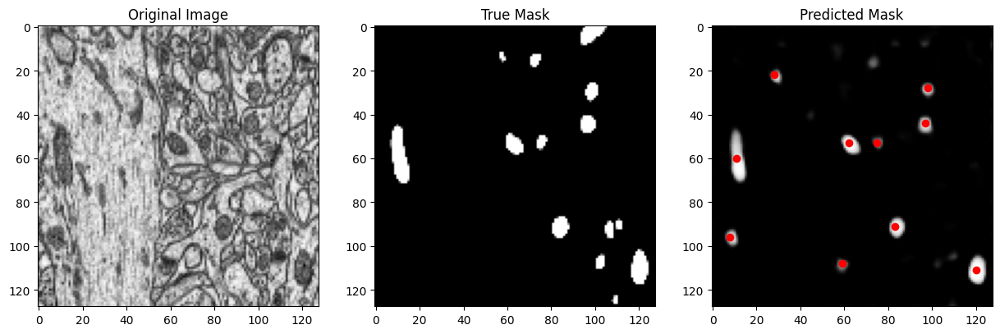

Centroids of predicted mask 120: [(28, 22), (98, 28), (97, 44), (11, 60), (62, 53), (75, 53), (83, 91), (8, 96), (120, 111), (59, 108)]


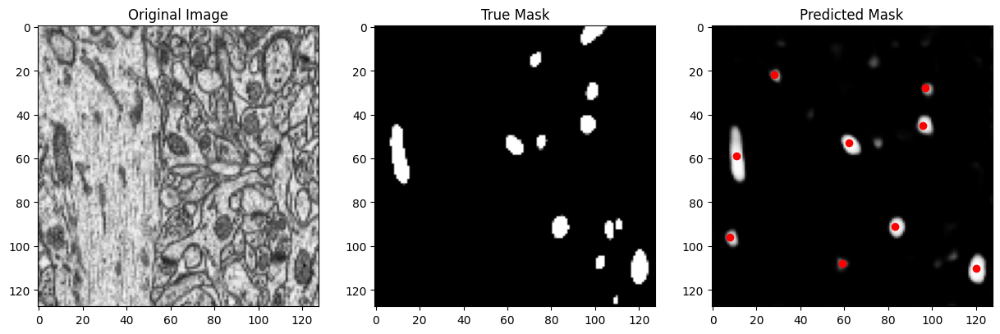

Centroids of predicted mask 121: [(28, 22), (97, 28), (96, 45), (11, 59), (62, 53), (83, 91), (8, 96), (120, 110), (59, 108)]


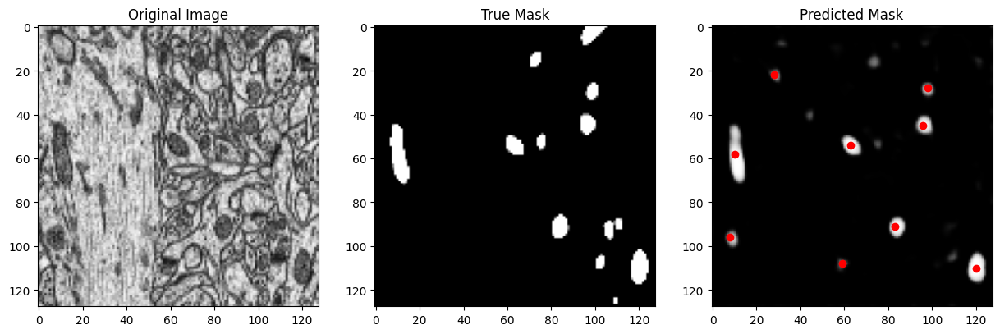

Centroids of predicted mask 122: [(28, 22), (98, 28), (96, 45), (10, 58), (63, 54), (83, 91), (8, 96), (120, 110), (59, 108)]


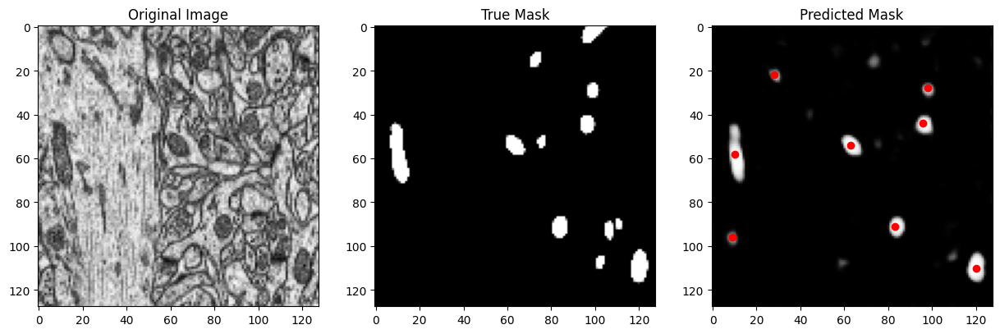

Centroids of predicted mask 123: [(28, 22), (98, 28), (96, 44), (10, 58), (63, 54), (83, 91), (9, 96), (120, 110)]


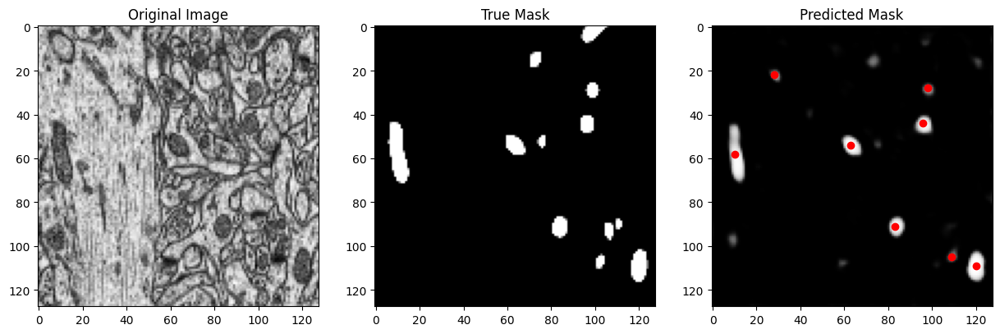

Centroids of predicted mask 124: [(28, 22), (98, 28), (96, 44), (10, 58), (63, 54), (83, 91), (120, 109), (109, 105)]


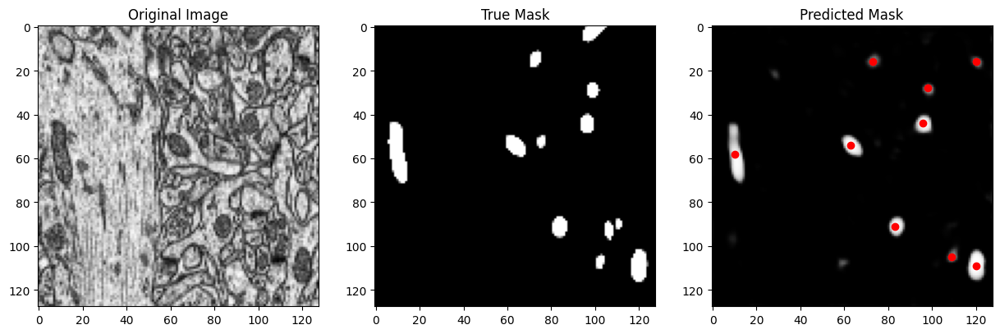

Centroids of predicted mask 125: [(73, 16), (120, 16), (98, 28), (96, 44), (10, 58), (63, 54), (83, 91), (120, 109), (109, 105)]


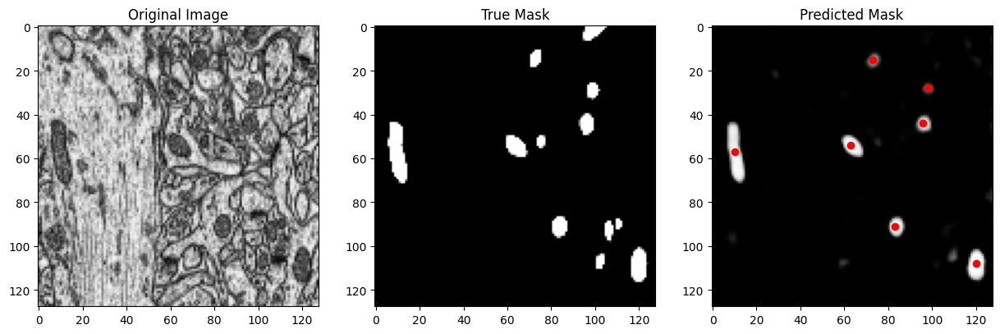

Centroids of predicted mask 126: [(73, 15), (98, 28), (96, 44), (10, 57), (63, 54), (83, 91), (120, 108)]


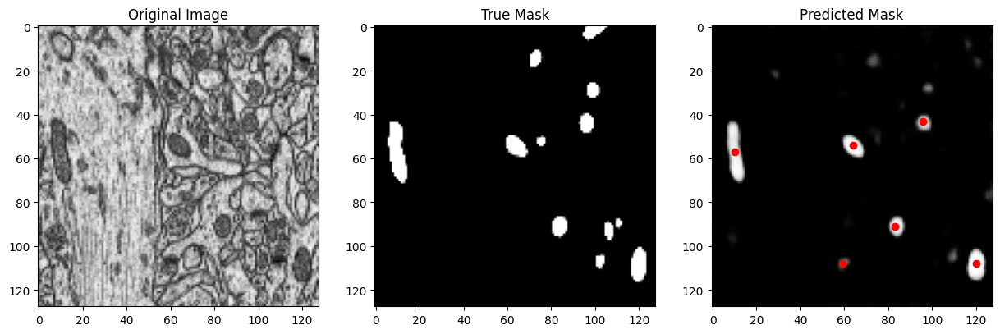

Centroids of predicted mask 127: [(96, 43), (10, 57), (64, 54), (83, 91), (120, 108), (59, 108)]


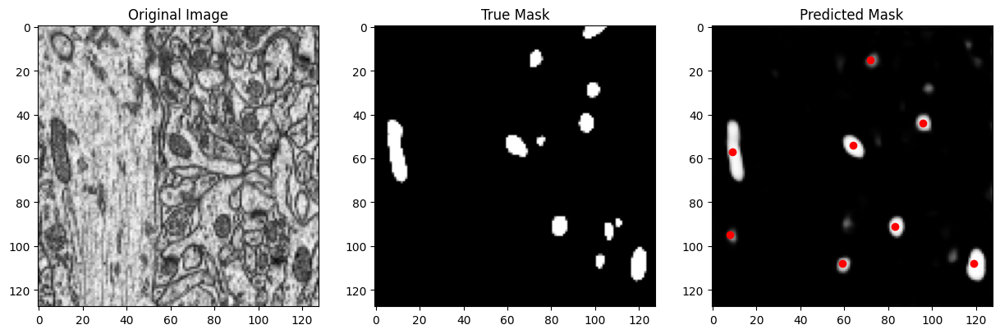

Centroids of predicted mask 128: [(72, 15), (96, 44), (9, 57), (64, 54), (83, 91), (8, 95), (119, 108), (59, 108)]


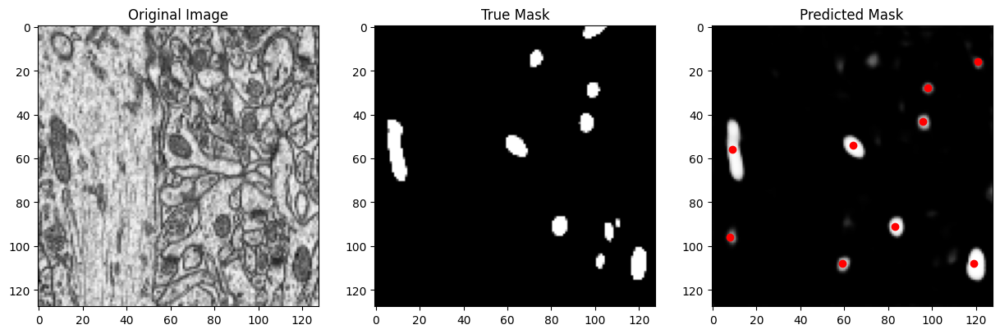

Centroids of predicted mask 129: [(121, 16), (98, 28), (96, 43), (9, 56), (64, 54), (83, 91), (8, 96), (119, 108), (59, 108)]


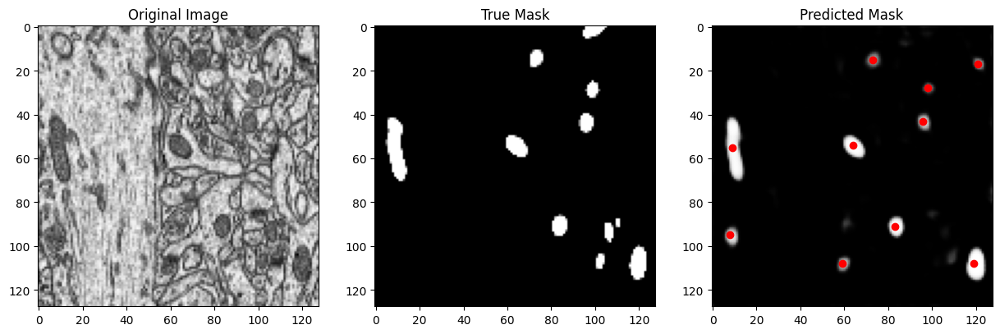

Centroids of predicted mask 130: [(73, 15), (121, 17), (98, 28), (96, 43), (9, 55), (64, 54), (83, 91), (8, 95), (119, 108), (59, 108)]


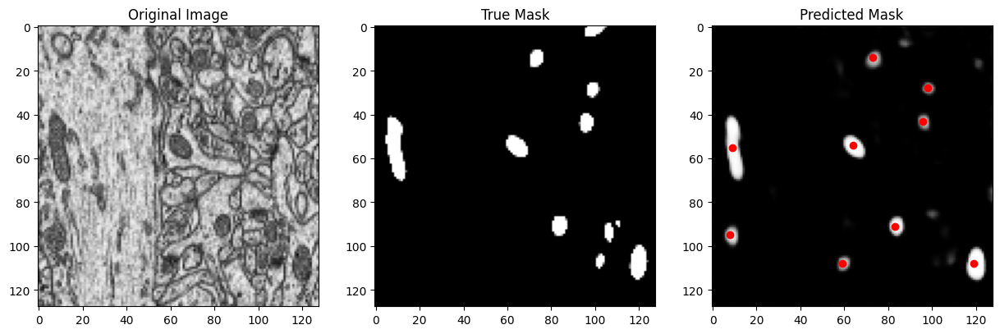

Centroids of predicted mask 131: [(73, 14), (98, 28), (96, 43), (9, 55), (64, 54), (83, 91), (8, 95), (119, 108), (59, 108)]


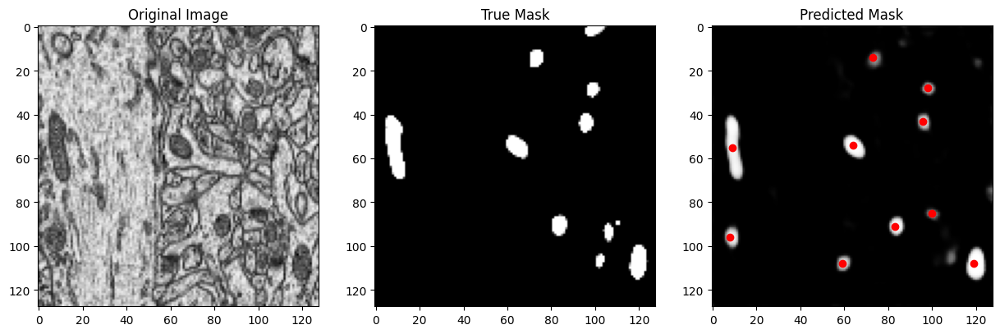

Centroids of predicted mask 132: [(73, 14), (98, 28), (9, 55), (96, 43), (64, 54), (100, 85), (83, 91), (8, 96), (119, 108), (59, 108)]


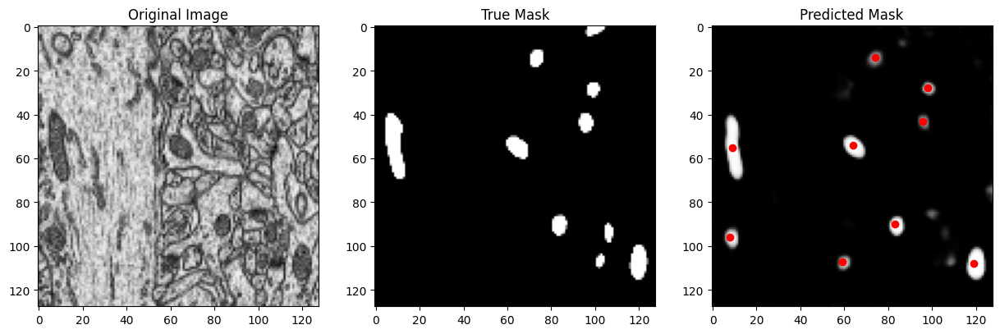

Centroids of predicted mask 133: [(74, 14), (98, 28), (9, 55), (96, 43), (64, 54), (83, 90), (8, 96), (119, 108), (59, 107)]


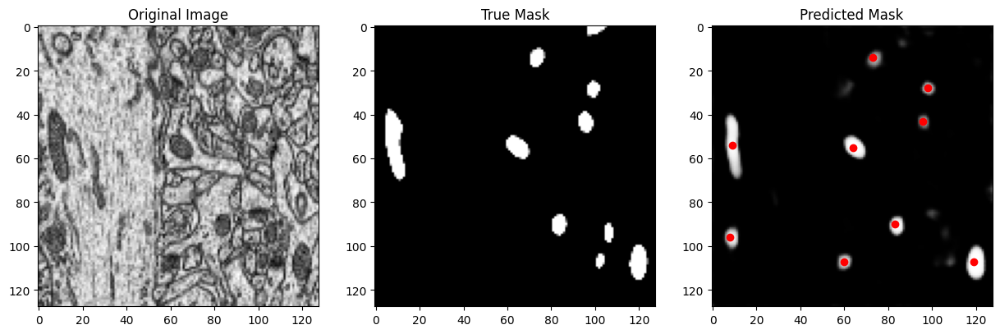

Centroids of predicted mask 134: [(73, 14), (98, 28), (9, 54), (96, 43), (64, 55), (83, 90), (8, 96), (119, 107), (60, 107)]


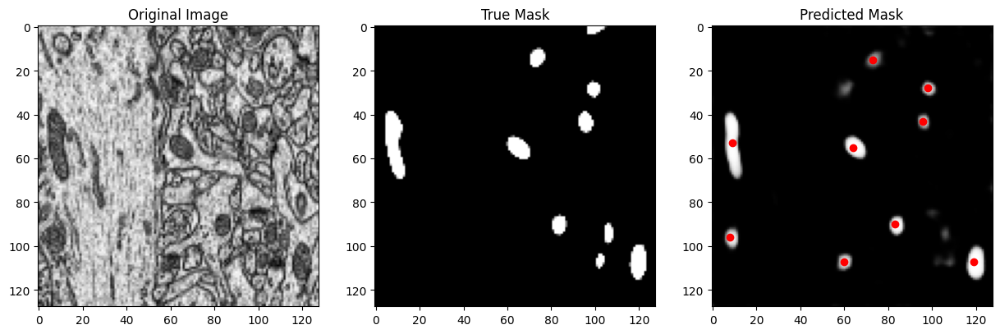

Centroids of predicted mask 135: [(73, 15), (98, 28), (9, 53), (96, 43), (64, 55), (83, 90), (8, 96), (119, 107), (60, 107)]


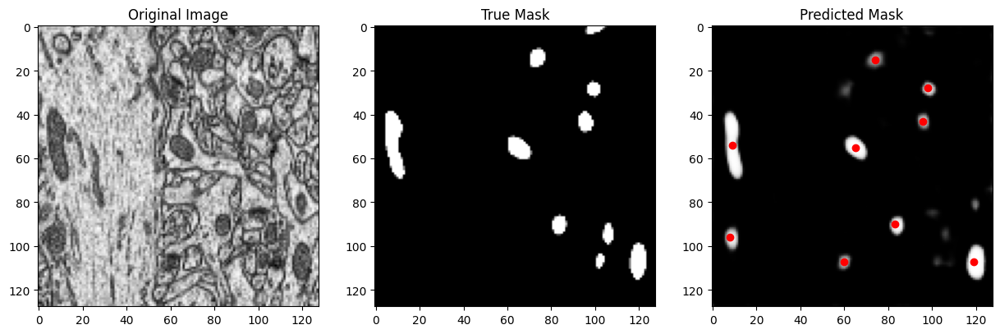

Centroids of predicted mask 136: [(74, 15), (98, 28), (9, 54), (96, 43), (65, 55), (83, 90), (8, 96), (119, 107), (60, 107)]


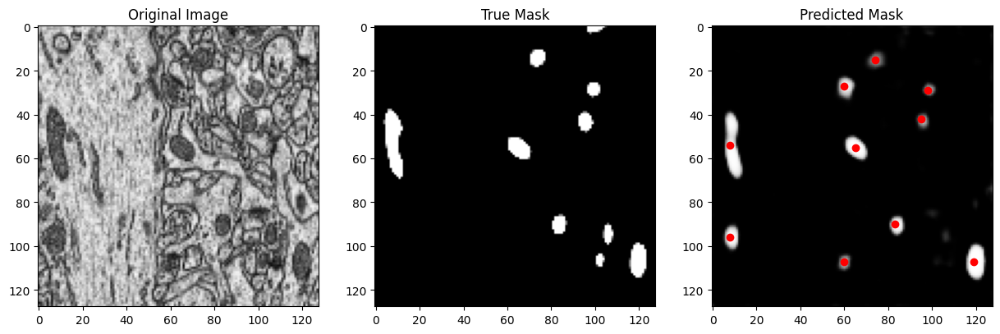

Centroids of predicted mask 137: [(74, 15), (60, 27), (98, 29), (8, 54), (95, 42), (65, 55), (83, 90), (8, 96), (119, 107), (60, 107)]


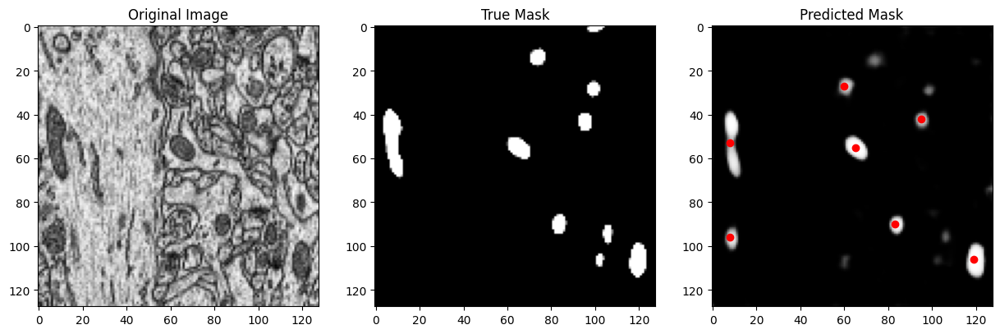

Centroids of predicted mask 138: [(60, 27), (8, 53), (95, 42), (65, 55), (83, 90), (8, 96), (119, 106)]


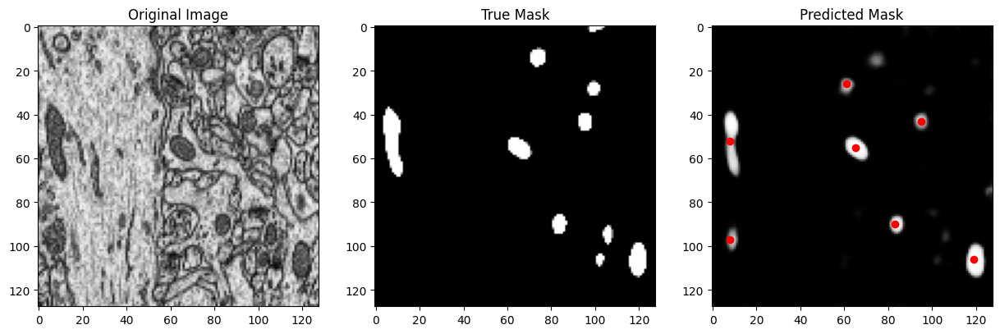

Centroids of predicted mask 139: [(61, 26), (8, 52), (95, 43), (65, 55), (83, 90), (8, 97), (119, 106)]


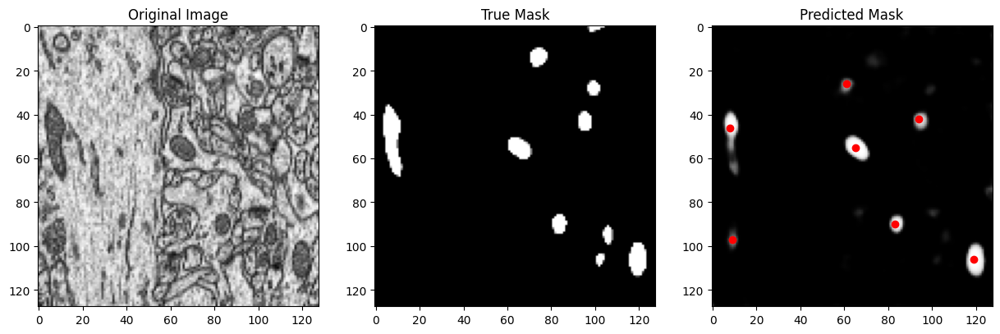

Centroids of predicted mask 140: [(61, 26), (8, 46), (94, 42), (65, 55), (83, 90), (9, 97), (119, 106)]


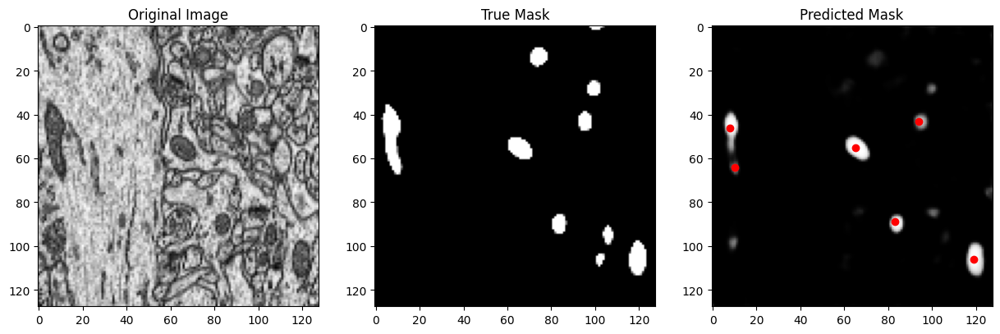

Centroids of predicted mask 141: [(8, 46), (94, 43), (65, 55), (10, 64), (83, 89), (119, 106)]


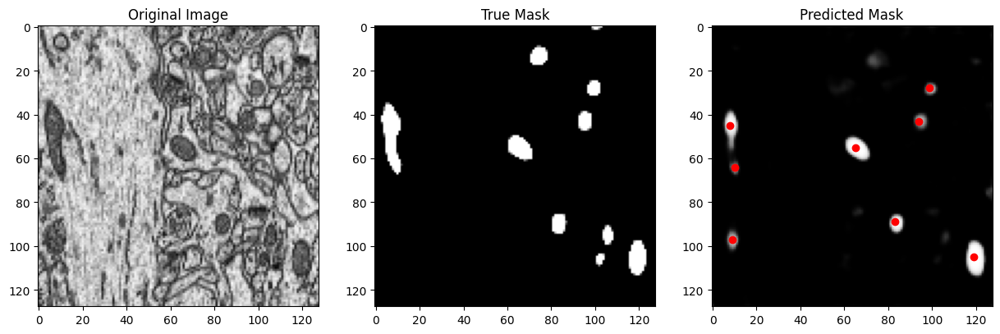

Centroids of predicted mask 142: [(99, 28), (8, 45), (94, 43), (65, 55), (10, 64), (83, 89), (9, 97), (119, 105)]


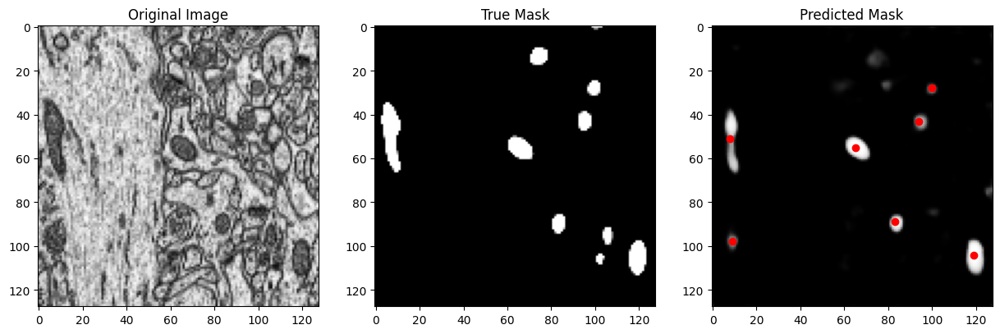

Centroids of predicted mask 143: [(100, 28), (8, 51), (94, 43), (65, 55), (83, 89), (9, 98), (119, 104)]


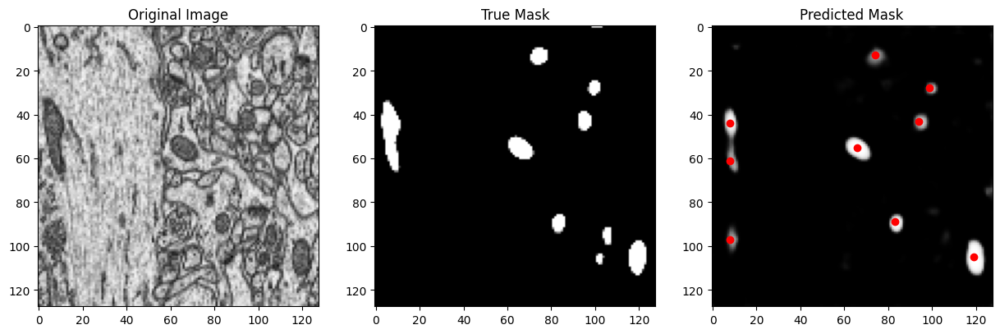

Centroids of predicted mask 144: [(74, 13), (99, 28), (8, 44), (94, 43), (66, 55), (8, 61), (83, 89), (8, 97), (119, 105)]


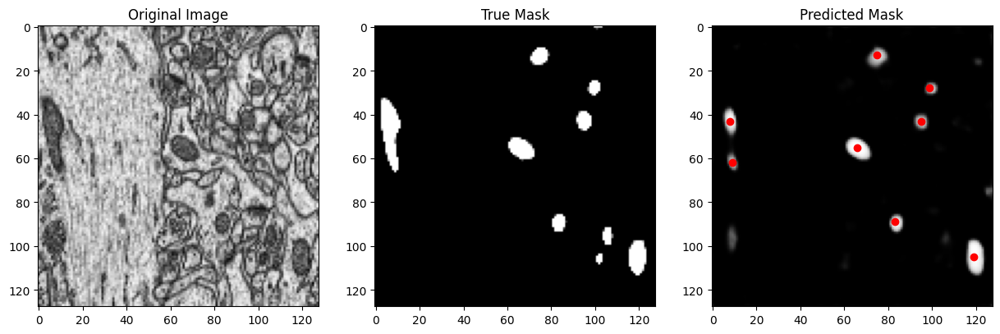

Centroids of predicted mask 145: [(75, 13), (99, 28), (8, 43), (95, 43), (66, 55), (9, 62), (83, 89), (119, 105)]


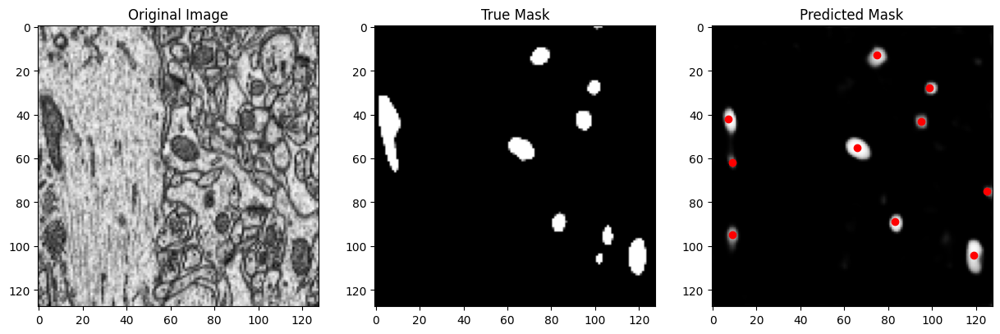

Centroids of predicted mask 146: [(75, 13), (99, 28), (7, 42), (95, 43), (66, 55), (9, 62), (125, 75), (83, 89), (9, 95), (119, 104)]


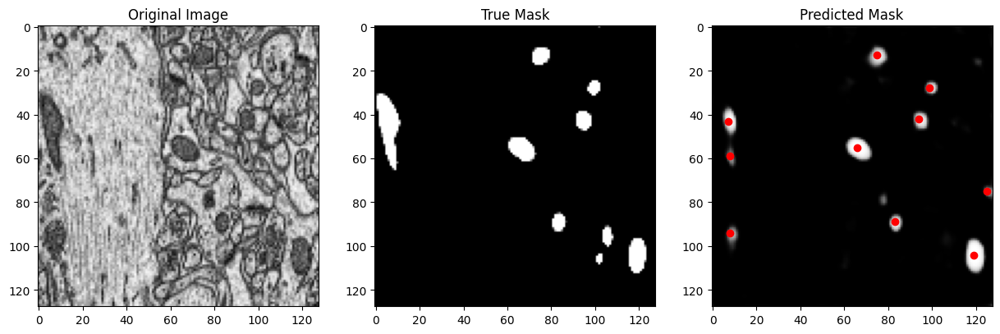

Centroids of predicted mask 147: [(75, 13), (99, 28), (7, 43), (94, 42), (66, 55), (8, 59), (125, 75), (83, 89), (8, 94), (119, 104)]


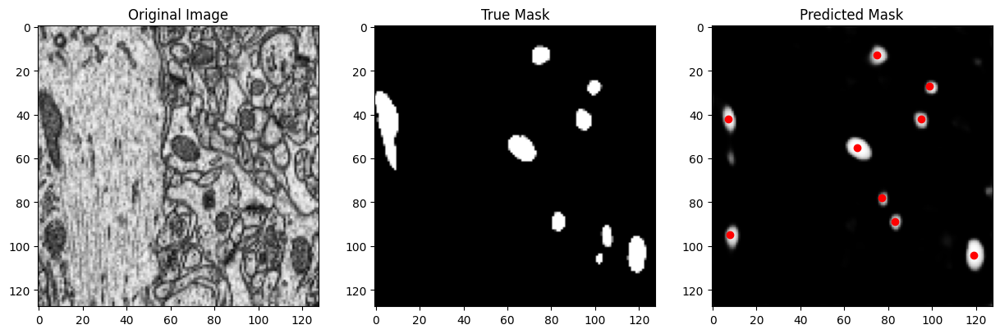

Centroids of predicted mask 148: [(75, 13), (99, 27), (7, 42), (95, 42), (66, 55), (77, 78), (83, 89), (8, 95), (119, 104)]


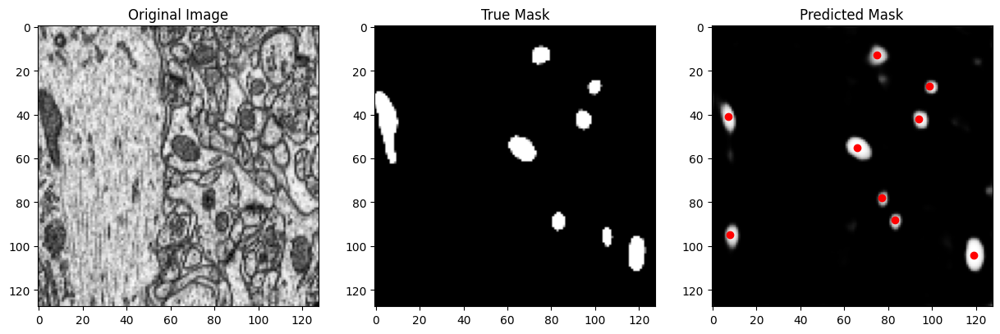

Centroids of predicted mask 149: [(75, 13), (99, 27), (7, 41), (94, 42), (66, 55), (77, 78), (83, 88), (8, 95), (119, 104)]


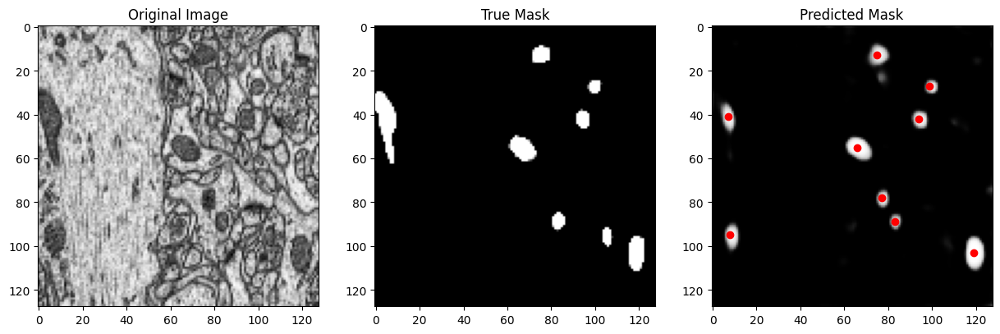

Centroids of predicted mask 150: [(75, 13), (99, 27), (7, 41), (94, 42), (66, 55), (77, 78), (83, 89), (8, 95), (119, 103)]


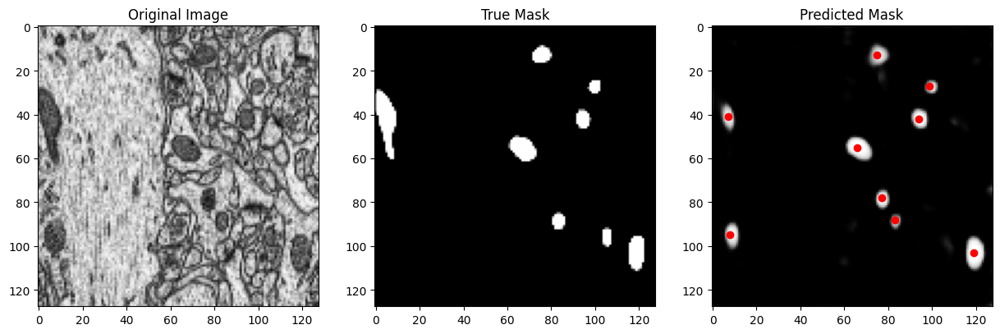

Centroids of predicted mask 151: [(75, 13), (99, 27), (7, 41), (94, 42), (66, 55), (77, 78), (83, 88), (8, 95), (119, 103)]


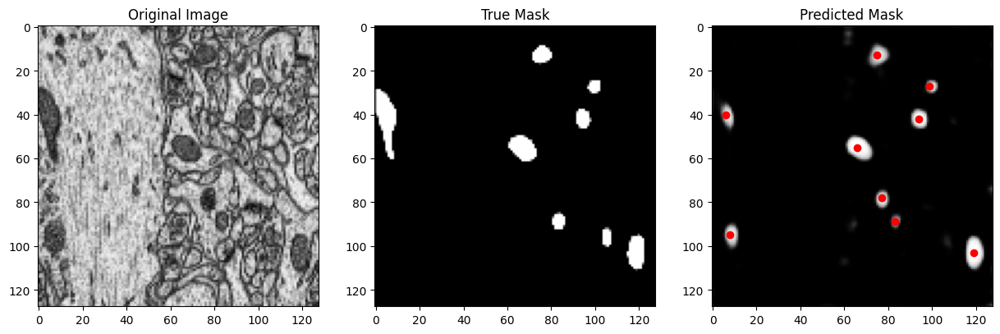

Centroids of predicted mask 152: [(75, 13), (99, 27), (6, 40), (94, 42), (66, 55), (77, 78), (83, 89), (8, 95), (119, 103)]


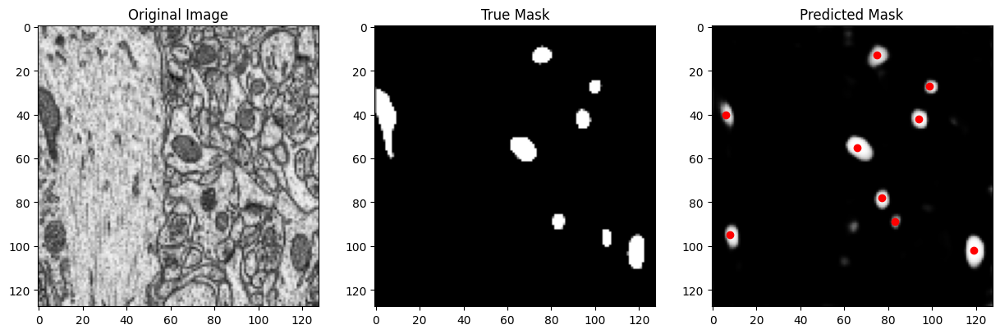

Centroids of predicted mask 153: [(75, 13), (99, 27), (6, 40), (94, 42), (66, 55), (77, 78), (83, 89), (8, 95), (119, 102)]


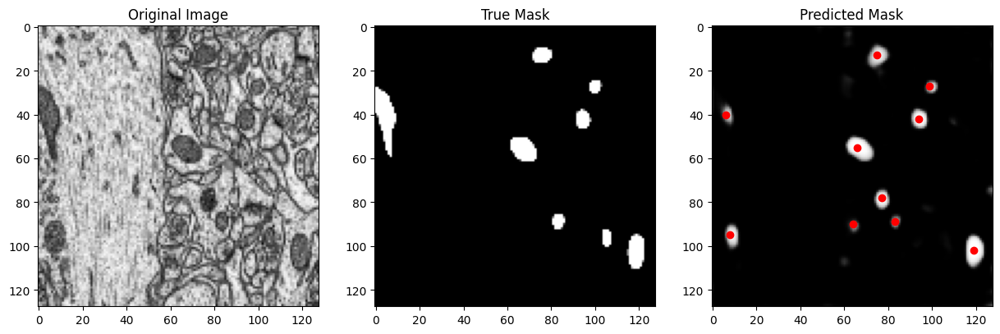

Centroids of predicted mask 154: [(75, 13), (99, 27), (6, 40), (94, 42), (66, 55), (77, 78), (83, 89), (64, 90), (8, 95), (119, 102)]


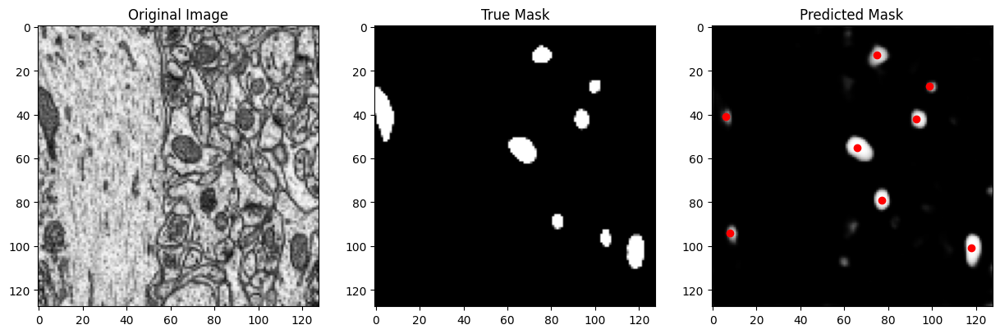

Centroids of predicted mask 155: [(75, 13), (99, 27), (93, 42), (6, 41), (66, 55), (77, 79), (8, 94), (118, 101)]


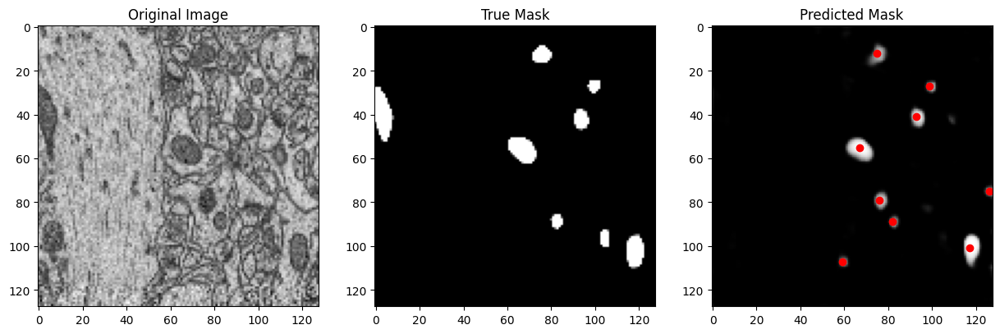

Centroids of predicted mask 156: [(75, 12), (99, 27), (93, 41), (67, 55), (126, 75), (76, 79), (82, 89), (117, 101), (59, 107)]


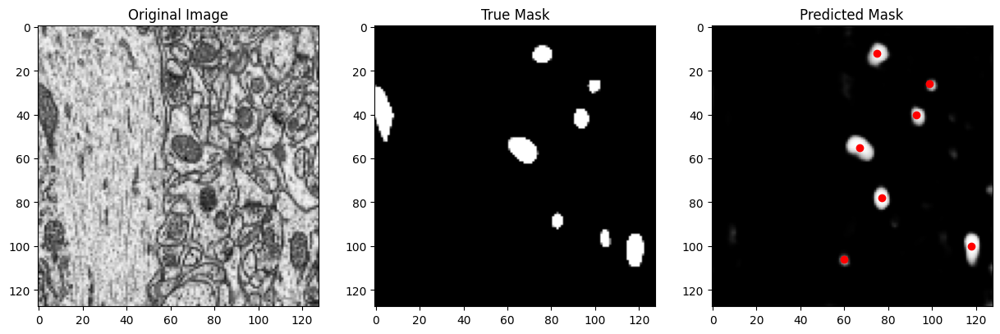

Centroids of predicted mask 157: [(75, 12), (99, 26), (93, 40), (67, 55), (77, 78), (118, 100), (60, 106)]


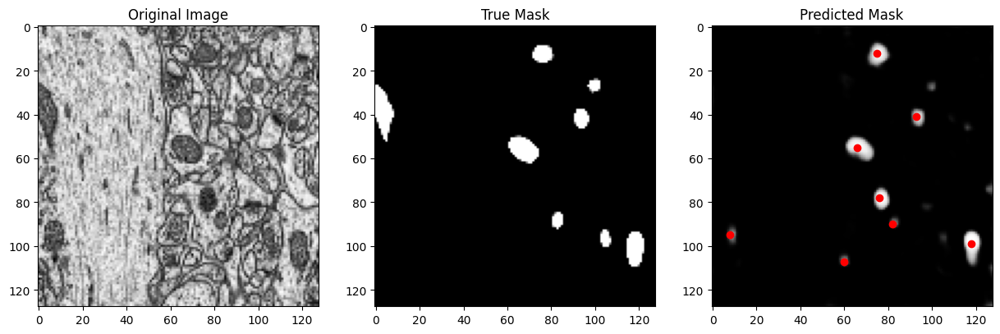

Centroids of predicted mask 158: [(75, 12), (93, 41), (66, 55), (76, 78), (82, 90), (8, 95), (118, 99), (60, 107)]


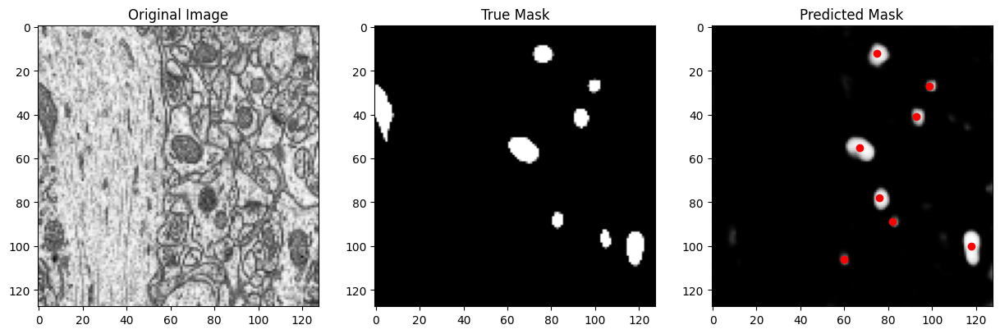

Centroids of predicted mask 159: [(75, 12), (99, 27), (93, 41), (67, 55), (76, 78), (82, 89), (118, 100), (60, 106)]


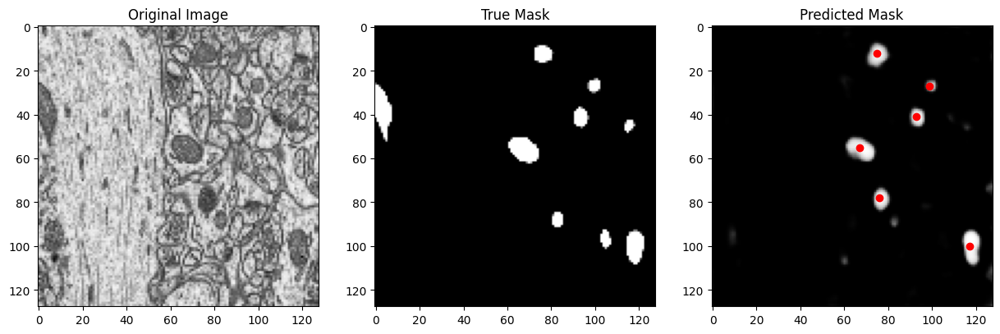

Centroids of predicted mask 160: [(75, 12), (99, 27), (93, 41), (67, 55), (76, 78), (117, 100)]


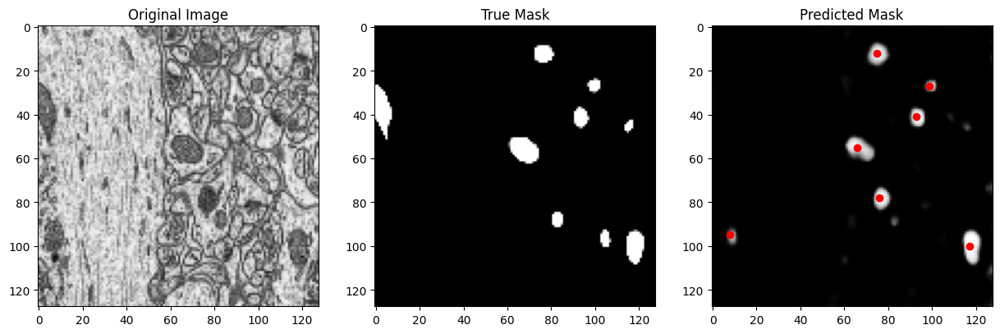

Centroids of predicted mask 161: [(75, 12), (99, 27), (93, 41), (66, 55), (76, 78), (8, 95), (117, 100)]


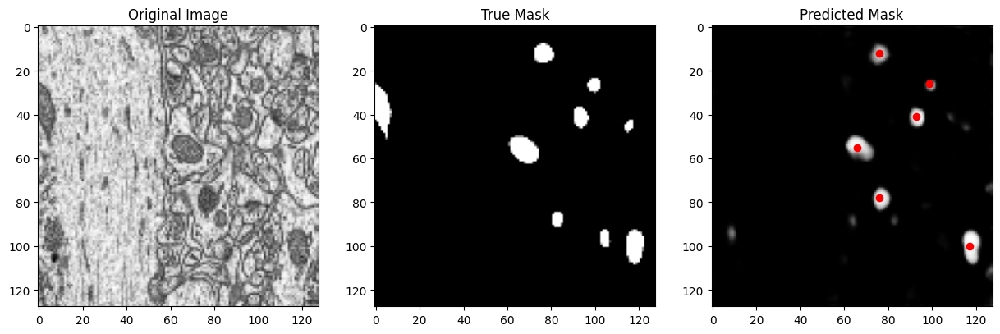

Centroids of predicted mask 162: [(76, 12), (99, 26), (93, 41), (66, 55), (76, 78), (117, 100)]


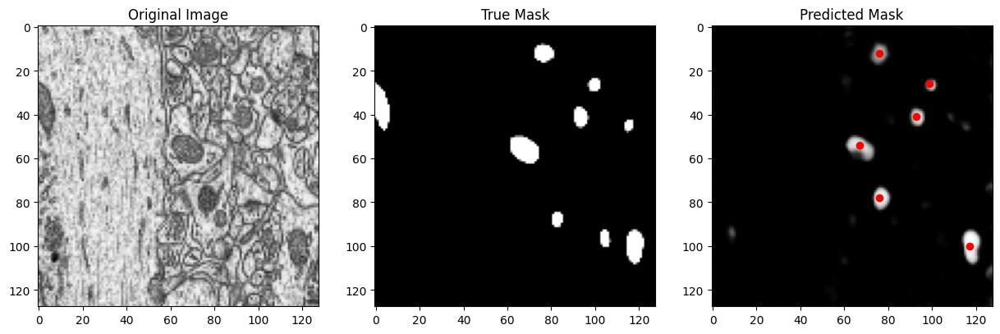

Centroids of predicted mask 163: [(76, 12), (99, 26), (93, 41), (67, 54), (76, 78), (117, 100)]


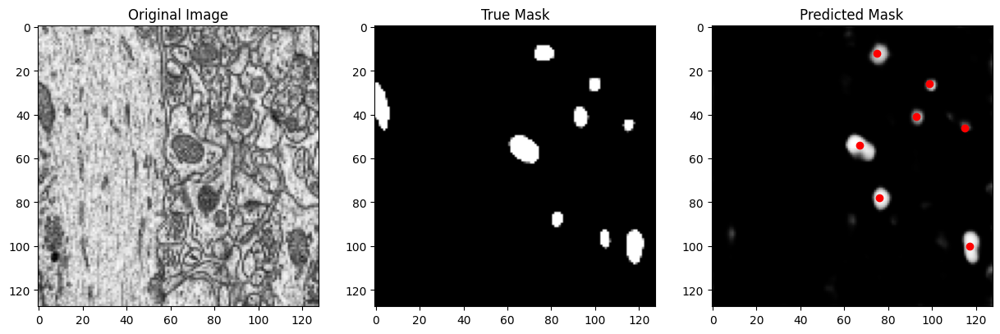

Centroids of predicted mask 164: [(75, 12), (99, 26), (93, 41), (115, 46), (67, 54), (76, 78), (117, 100)]


In [9]:
# Display results for all test images
for i in range(len(resized_test_images)):
    plot_results(i, resized_test_images[i], resized_test_masks[i], all_test_predictions[i])


In [11]:
# Function to save centroids to a TXT file
def save_centroids_to_txt(predicted_masks, file_name='centroids.txt'):
    centroids_dict = {}
    for i in range(len(predicted_masks)):
        centroids = find_centroids(predicted_masks[i])
        centroids_dict[i] = centroids

    with open(file_name, 'w') as file:
        for index, centroids in centroids_dict.items():
            file.write(f"{index}: {centroids}\n")

# Save centroids of all test images to a TXT file
save_centroids_to_txt(all_test_predictions, file_name='/content/drive/MyDrive/Mitochondria-Data/Data/txt/test_centroids.txt')


In [ ]:
from matplotlib.backends.backend_pdf import PdfPages

# Function to save images as PDF
def save_images_as_pdf(images, true_masks, predicted_masks, file_name='output.pdf'):
    with PdfPages(file_name) as pdf:
        for i in range(len(images)):
            fig, axs = plt.subplots(1, 3, figsize=(15, 5))
            axs[0].imshow(images[i].squeeze(), cmap='gray')
            axs[0].set_title("Original Image")
            axs[1].imshow(true_masks[i].squeeze(), cmap='gray')
            axs[1].set_title("True Mask")
            axs[2].imshow(predicted_masks[i].squeeze(), cmap='gray')
            axs[2].set_title("Predicted Mask")

            for ax in axs:
                ax.axis('off')

            pdf.savefig(fig)
            plt.close()

# Save all test images, true masks, and predicted masks to a PDF
save_images_as_pdf(resized_test_images, resized_test_masks, all_test_predictions, file_name='test_predictions.pdf')
